<a href="https://colab.research.google.com/github/btknzn/TiagoRobotSkillLearning/blob/main/autoencoderBLACKDARK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from matplotlib import pyplot as plt
import numpy as np

import torch
import torchvision
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import transforms
import torchvision.datasets as dset
from torchvision.utils import save_image
import torchvision.utils as vutils
from torchsummary import summary
from IPython import display
import torchvision.models as models
from torchvision import datasets, models, transforms
from google.colab import files
from matplotlib import pyplot as plt
import numpy as np

from matplotlib import pyplot as plt
import numpy as np

import torch
import torchvision
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import transforms
import torchvision.datasets as dset
from torchvision.utils import save_image
import torchvision.utils as vutils
from torchsummary import summary
from IPython import display

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd /content/drive/MyDrive/Autoencoder/data/

/content/drive/MyDrive/Autoencoder/data


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


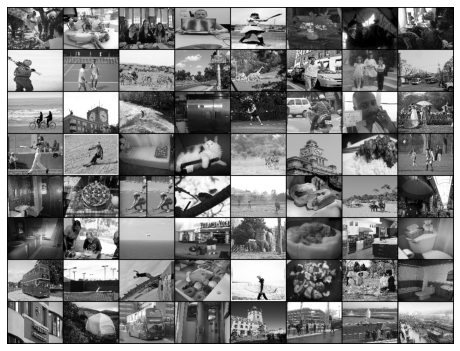

In [ ]:
dataroot = "."

image_size = 256
image_size1 = 96
image_size2 = 128
nb_channls=1
workers=4
num_epochs = 10
batch_size = 64
learning_rate = 1e-3
weight_decay = 1e-5

device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

    
def to_img(x):
    x = 0.5 * (x + 1)
    x = x.clamp(0, 1)
    x = x.view(x.size(0), nb_channls, image_size1, image_size2)
    return x

device

from torch.utils.data.sampler import SubsetRandomSampler
# Load Dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([transforms.Grayscale(num_output_channels=1), transforms.ToTensor(),
         transforms.Normalize(mean=[0.5], std=[0.5]), transforms.Resize((image_size1, image_size2))]))


random_seed= 42
shuffle_dataset = True
validation_split = 0.2
dataset_size = len(dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))
if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(indices)
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
valid_sampler = SubsetRandomSampler(val_indices)

train_dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         num_workers=workers,sampler=train_sampler )

val_dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         num_workers=workers,sampler=valid_sampler )

# Preview some images in dataset
batch = next(iter(train_dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
btch = batch[0].to(device)[:64]
plt.imshow(np.transpose(vutils.make_grid(btch, padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
class autoencoder(nn.Module):
    def __init__(self):
        super(autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=5,stride=2),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.Conv2d(16,32,kernel_size=5,stride=2),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.Conv2d(32,64,kernel_size=5,stride=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64,128,kernel_size=5,stride=2),
            nn.ReLU(),
            ) 
        
        self.decoder = nn.Sequential(
            
            nn.ConvTranspose2d(128,64,kernel_size=5,stride=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64,32,kernel_size=5,stride=2),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.ConvTranspose2d(32,16,kernel_size=5,stride=2,output_padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.ConvTranspose2d(16,1,kernel_size=5,stride=2,output_padding=1),
            nn.Sigmoid(),
            nn.BatchNorm2d(1)
            )    
    
    def forward(self,x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [ ]:
image_size1 = 96
image_size2 = 128
model = autoencoder().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
summary(model, (1, 96, 128))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 46, 62]             416
              ReLU-2           [-1, 16, 46, 62]               0
       BatchNorm2d-3           [-1, 16, 46, 62]              32
            Conv2d-4           [-1, 32, 21, 29]          12,832
              ReLU-5           [-1, 32, 21, 29]               0
       BatchNorm2d-6           [-1, 32, 21, 29]              64
            Conv2d-7            [-1, 64, 9, 13]          51,264
              ReLU-8            [-1, 64, 9, 13]               0
       BatchNorm2d-9            [-1, 64, 9, 13]             128
           Conv2d-10            [-1, 128, 3, 5]         204,928
             ReLU-11            [-1, 128, 3, 5]               0
  ConvTranspose2d-12            [-1, 64, 9, 13]         204,864
             ReLU-13            [-1, 64, 9, 13]               0
      BatchNorm2d-14            [-1, 64

iter [0], loss:0.4624
iter [0], val loss:0.4603 


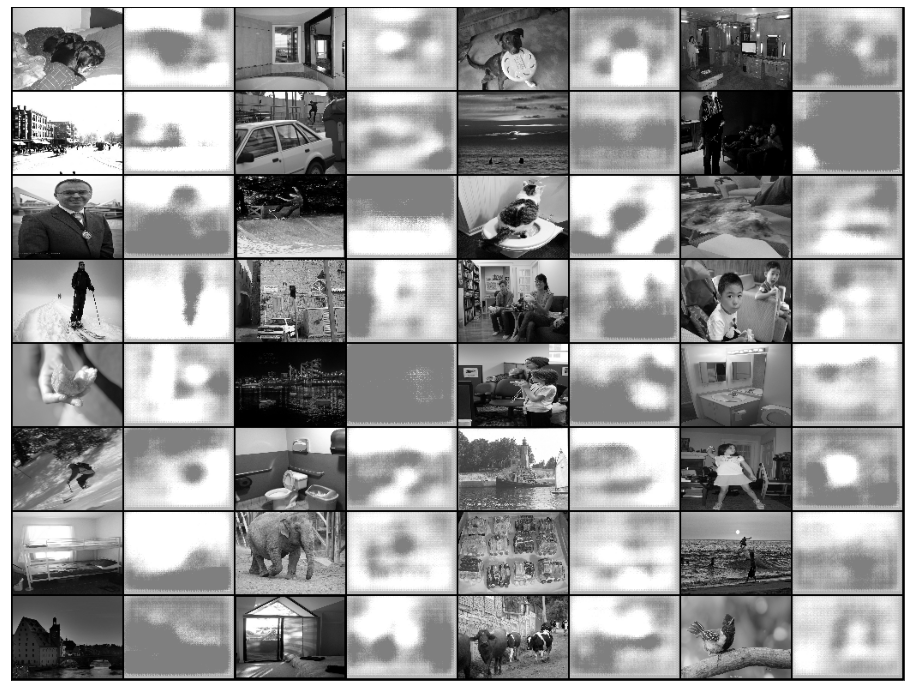

iter [10], loss:0.4353
iter [10], val loss:0.4231 


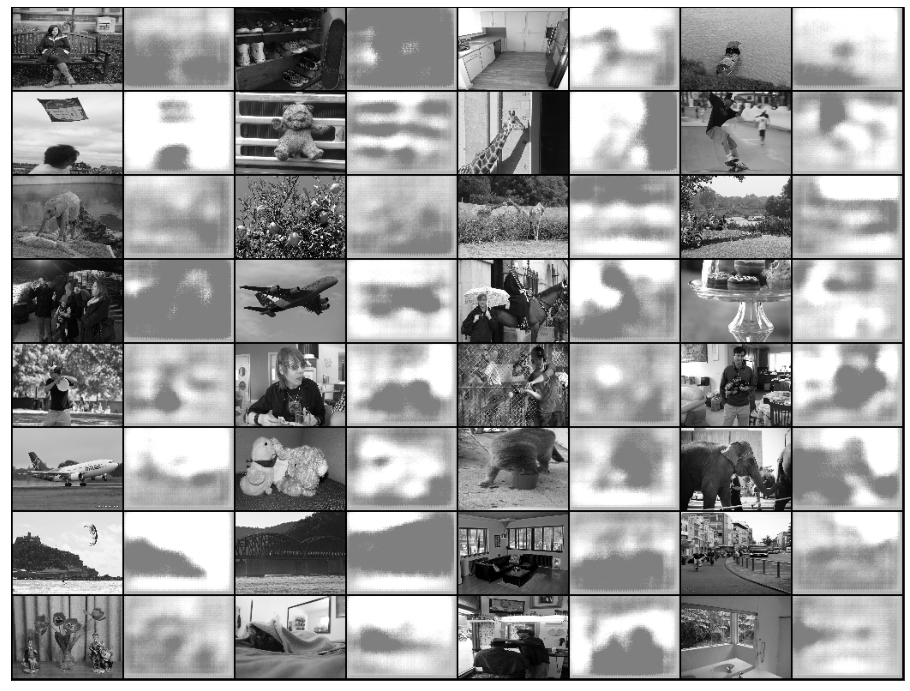

iter [20], loss:0.4214
iter [20], val loss:0.4246 


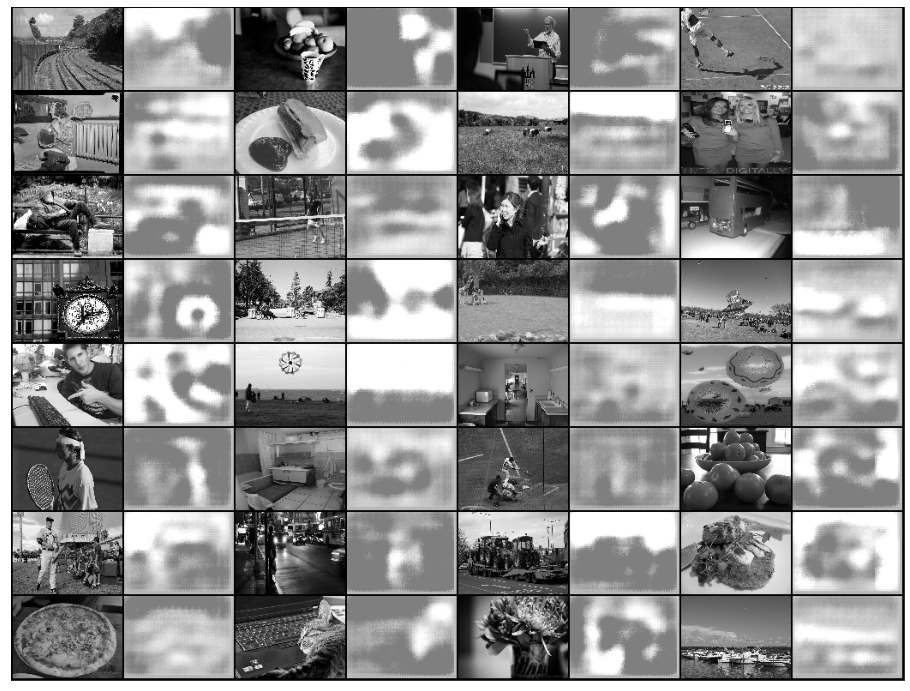

iter [30], loss:0.3589
iter [30], val loss:0.3778 


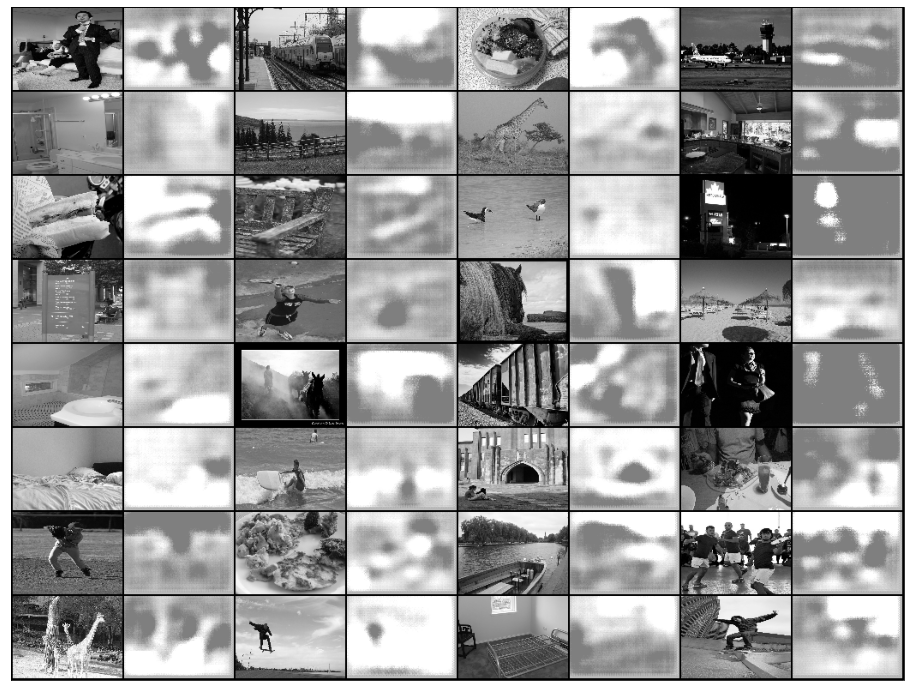

iter [40], loss:0.3829
iter [40], val loss:0.3689 


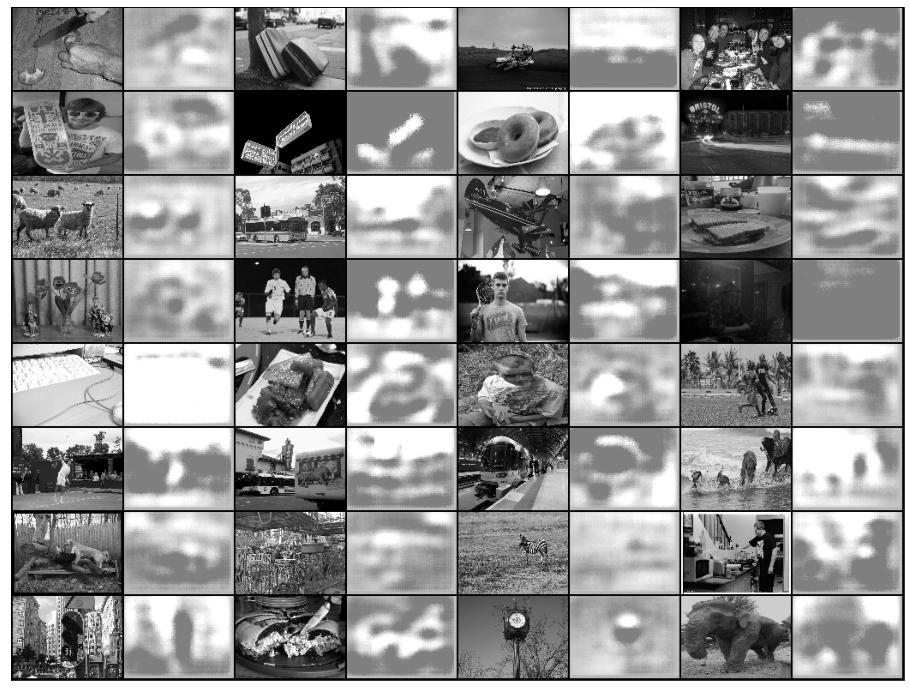

iter [50], loss:0.3332
iter [50], val loss:0.3620 


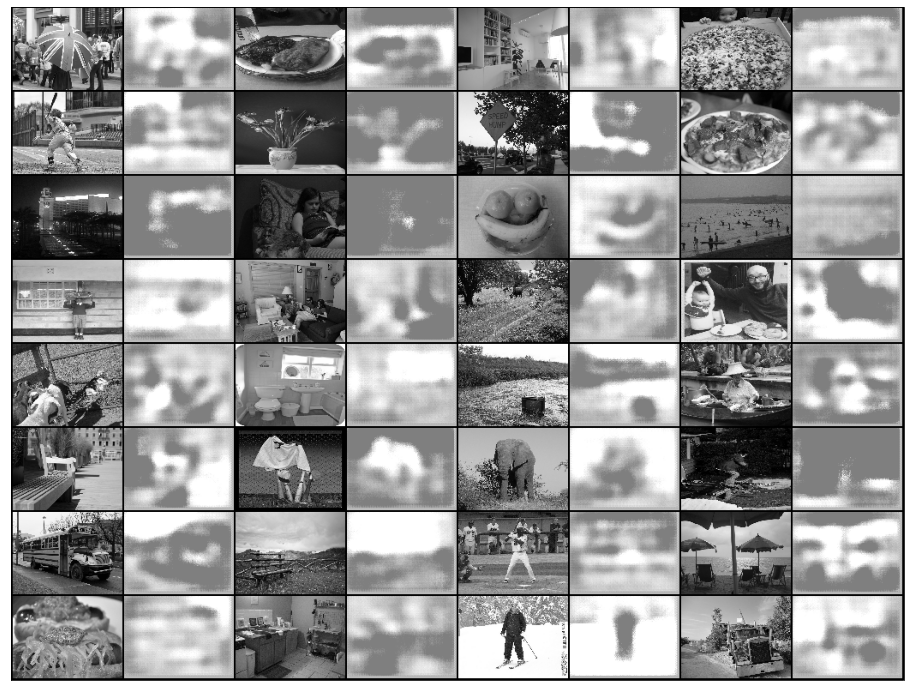

iter [60], loss:0.3255
iter [60], val loss:0.3282 


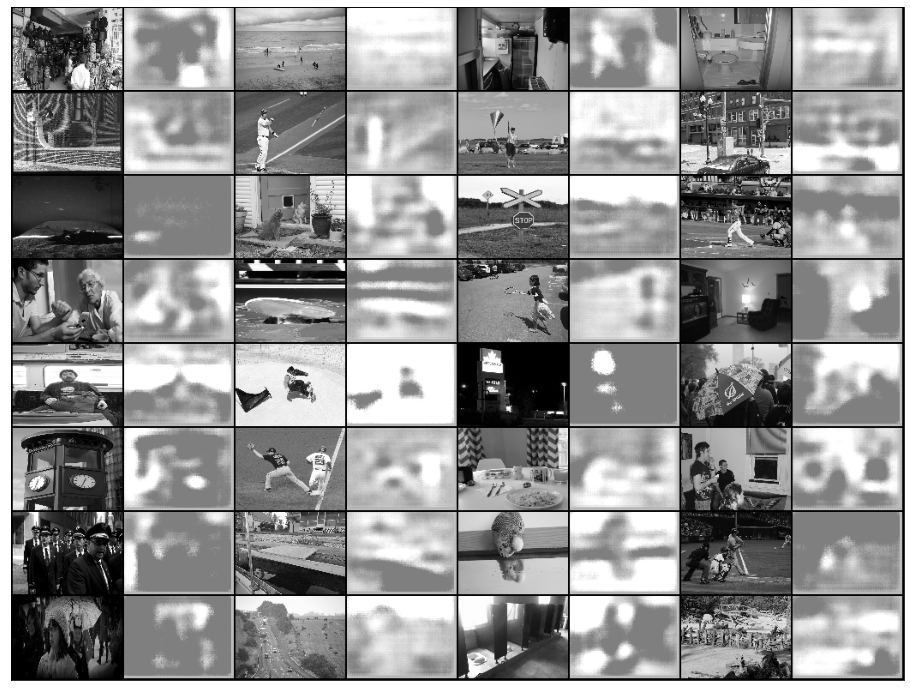

iter [70], loss:0.3251
iter [70], val loss:0.3371 


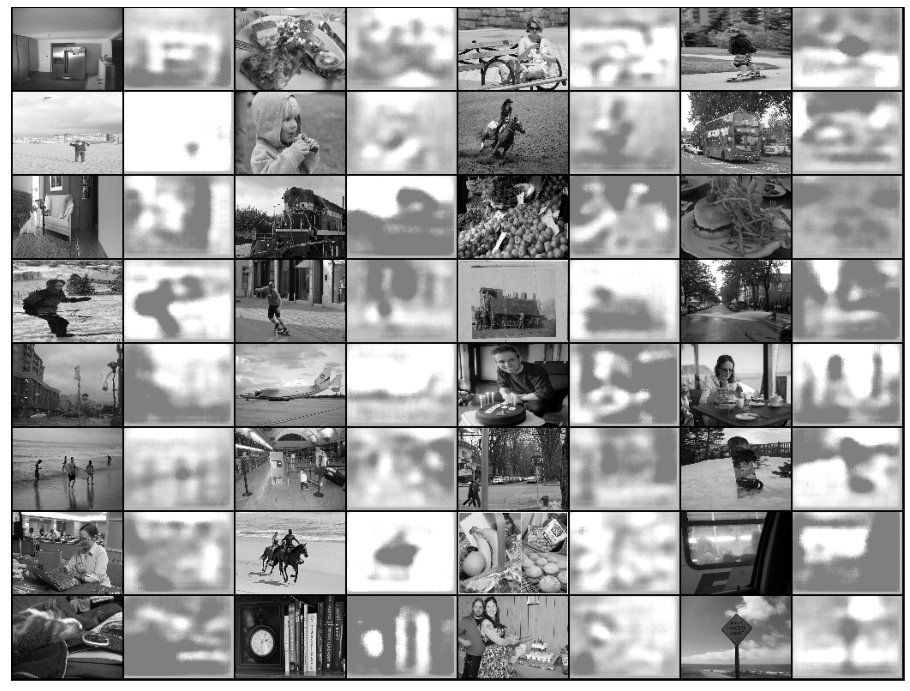

iter [80], loss:0.3139
iter [80], val loss:0.2971 


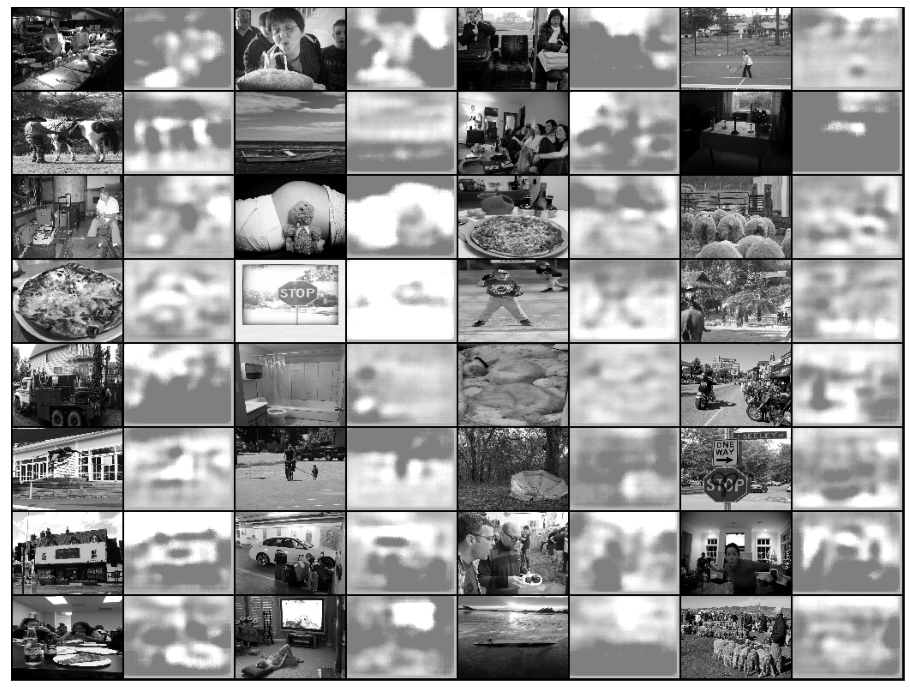

iter [90], loss:0.3067
iter [90], val loss:0.3055 


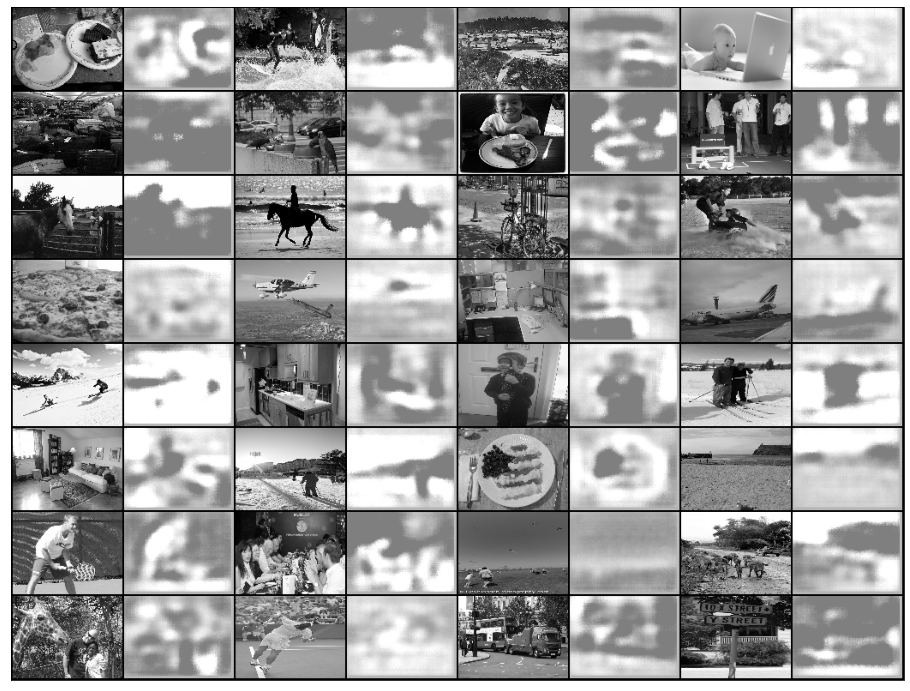

iter [100], loss:0.2758
iter [100], val loss:0.3019 


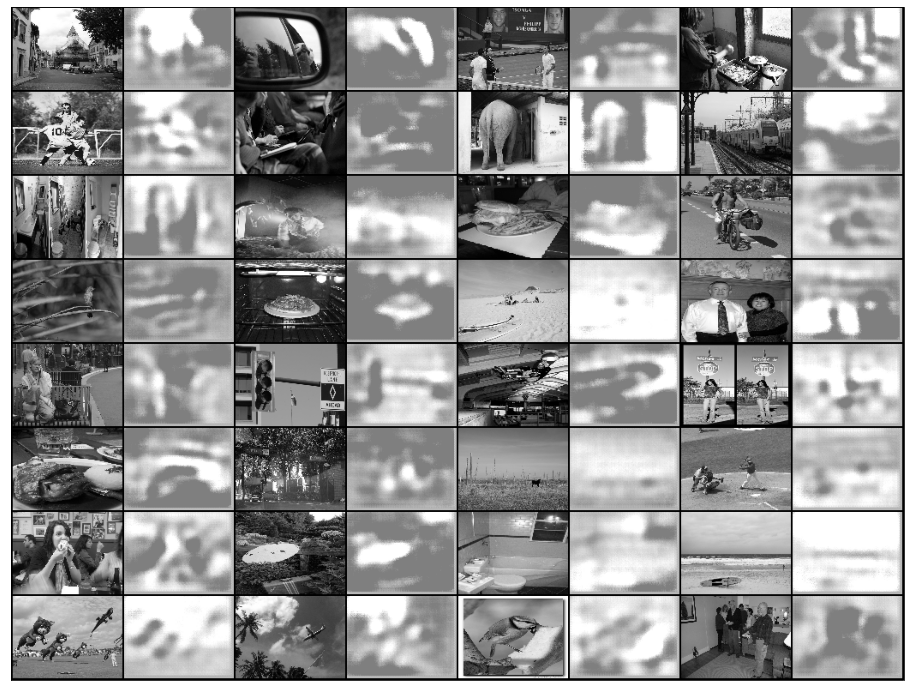

iter [110], loss:0.2956
iter [110], val loss:0.2789 


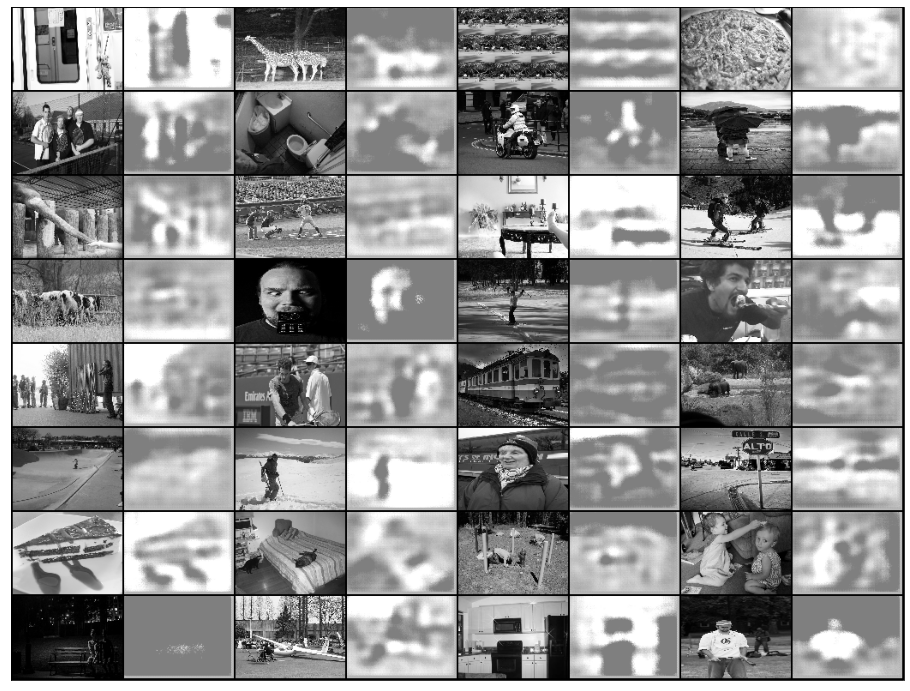

iter [120], loss:0.2669
iter [120], val loss:0.2901 


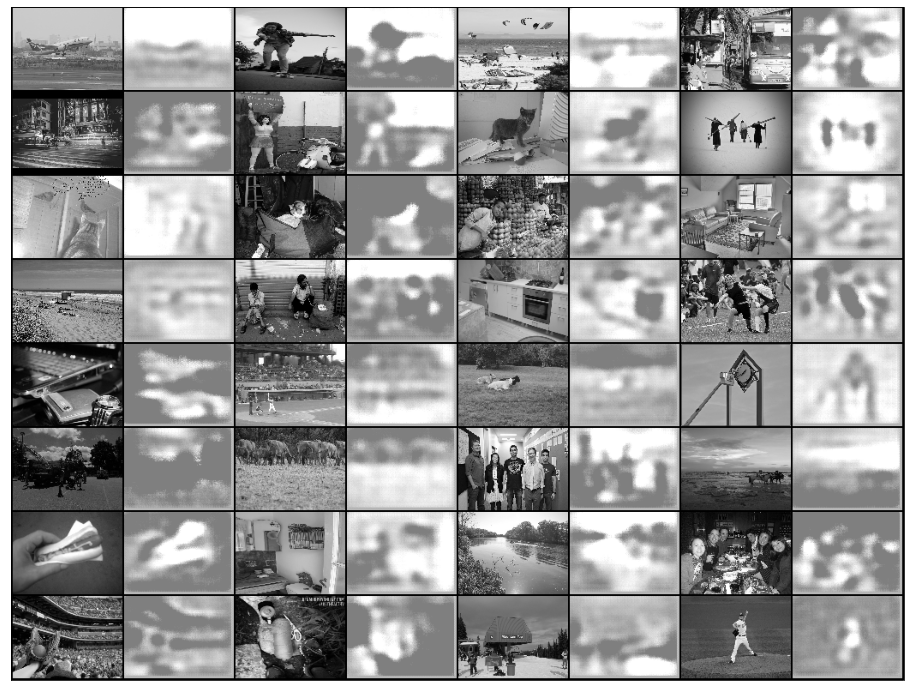

iter [130], loss:0.2448
iter [130], val loss:0.2603 


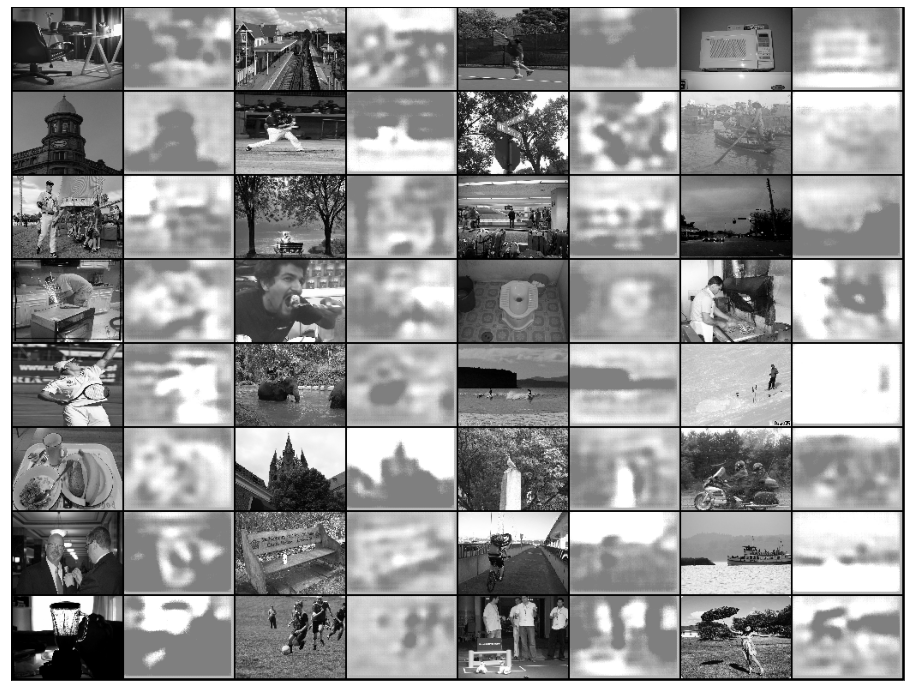

iter [140], loss:0.2642
iter [140], val loss:0.2329 


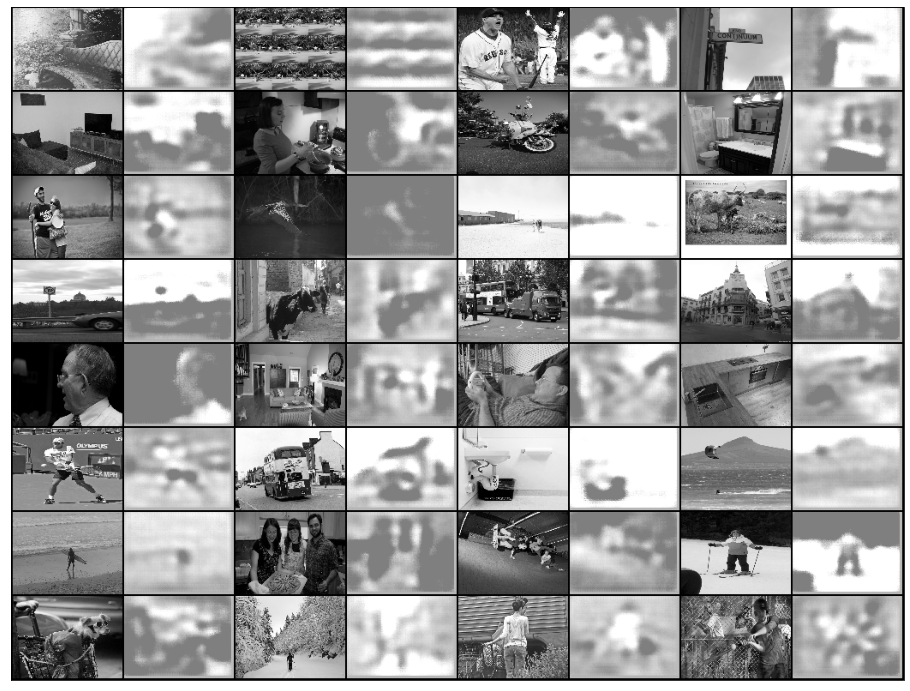

iter [150], loss:0.2515
iter [150], val loss:0.2402 


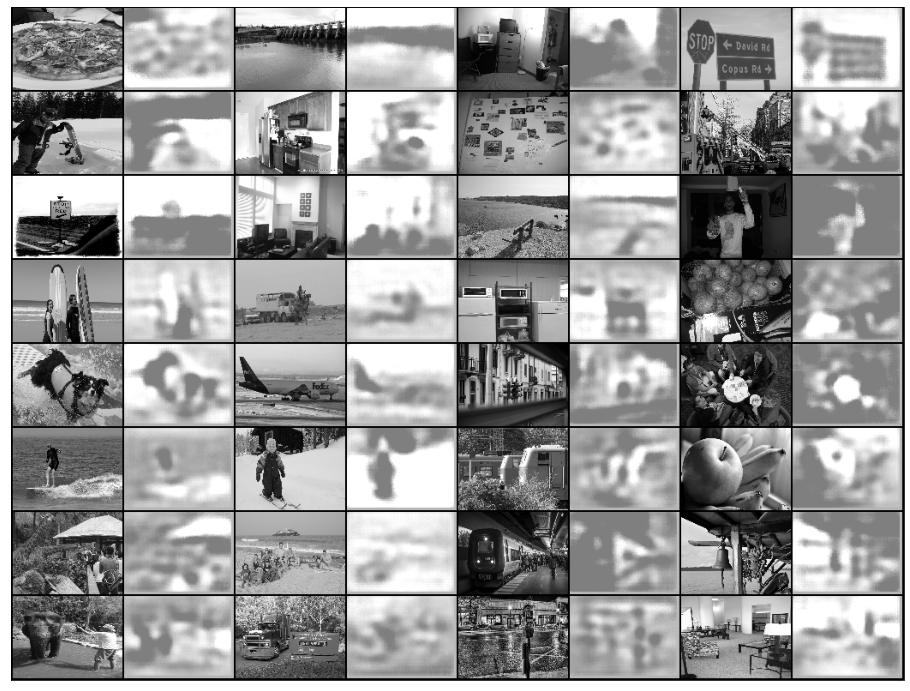

iter [160], loss:0.2423
iter [160], val loss:0.2497 


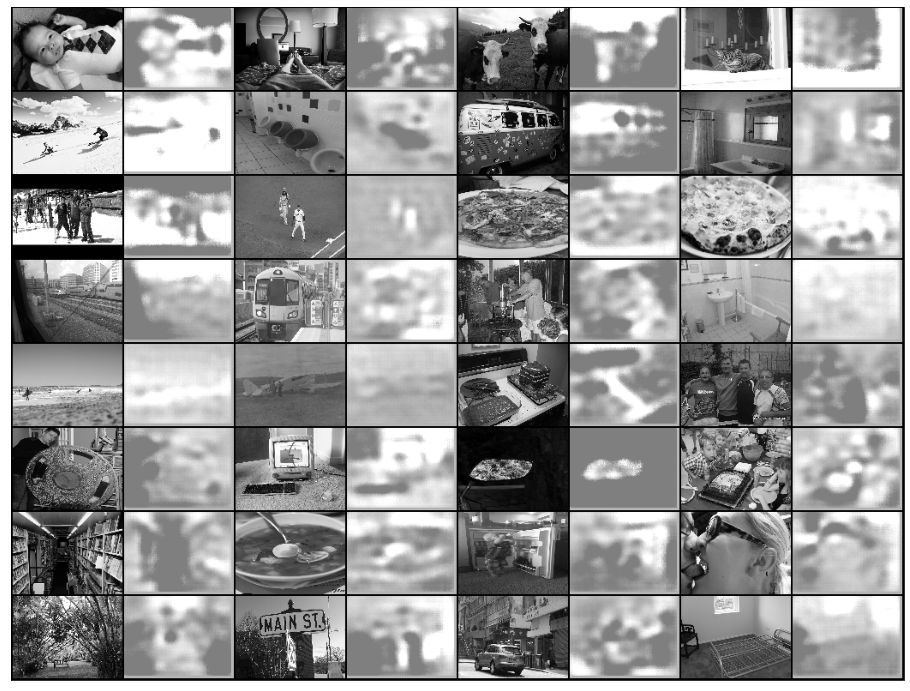

iter [170], loss:0.2452
iter [170], val loss:0.2341 


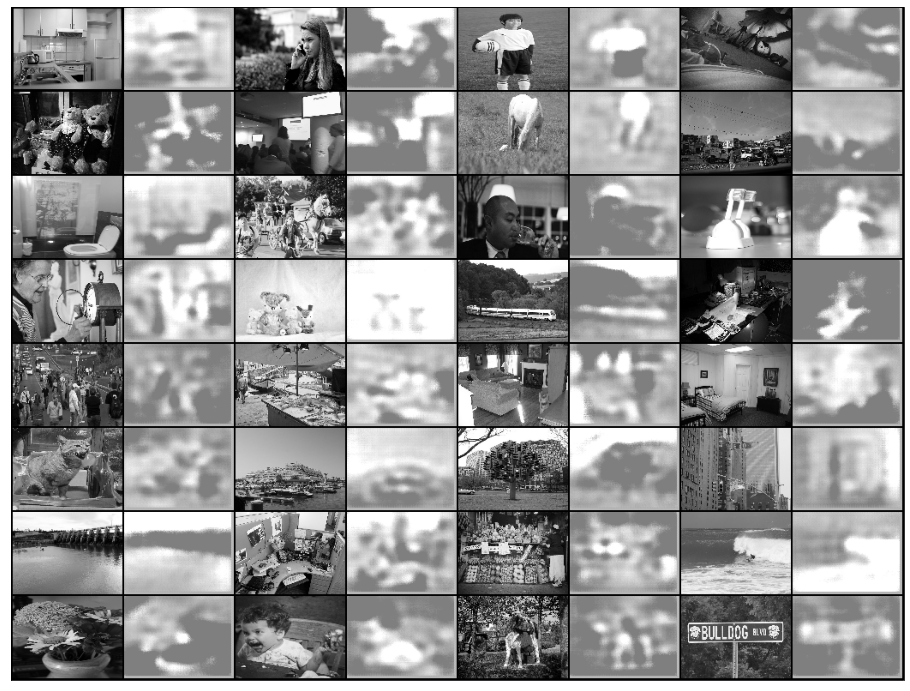

iter [180], loss:0.2345
iter [180], val loss:0.2263 


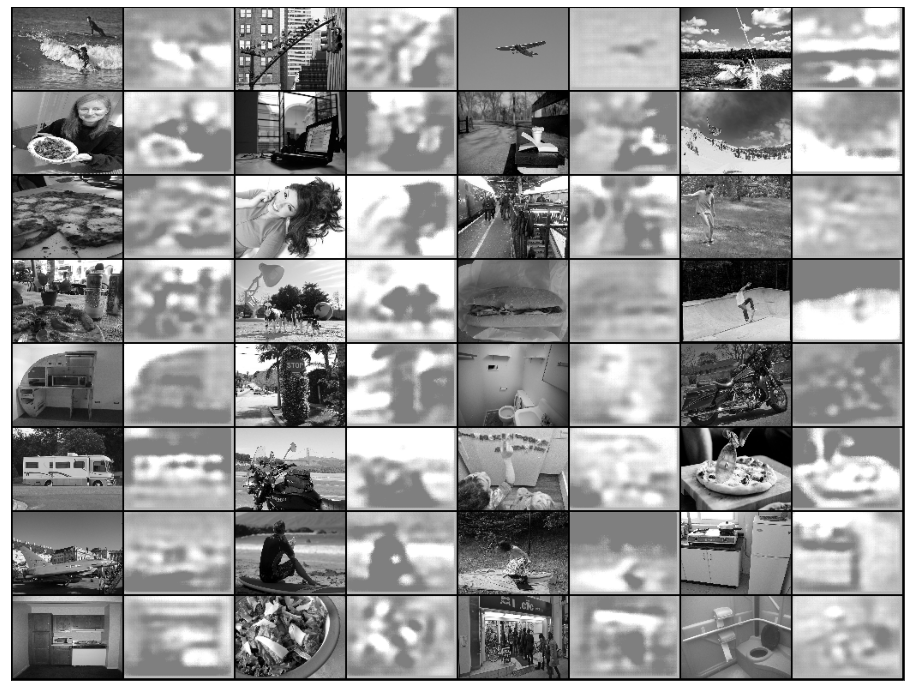

iter [190], loss:0.2320
iter [190], val loss:0.2135 


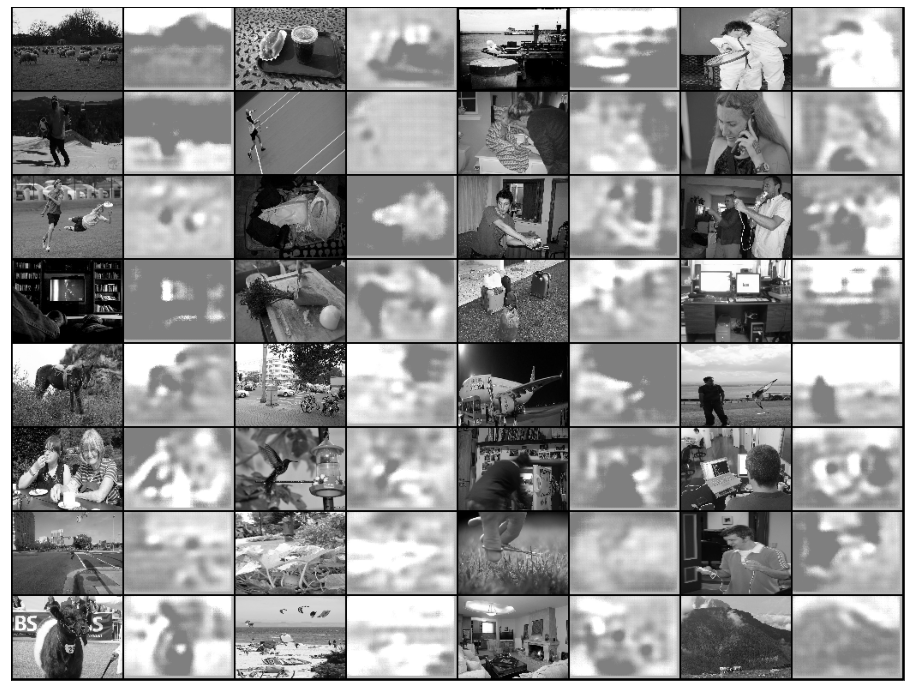

iter [200], loss:0.2168
iter [200], val loss:0.2107 


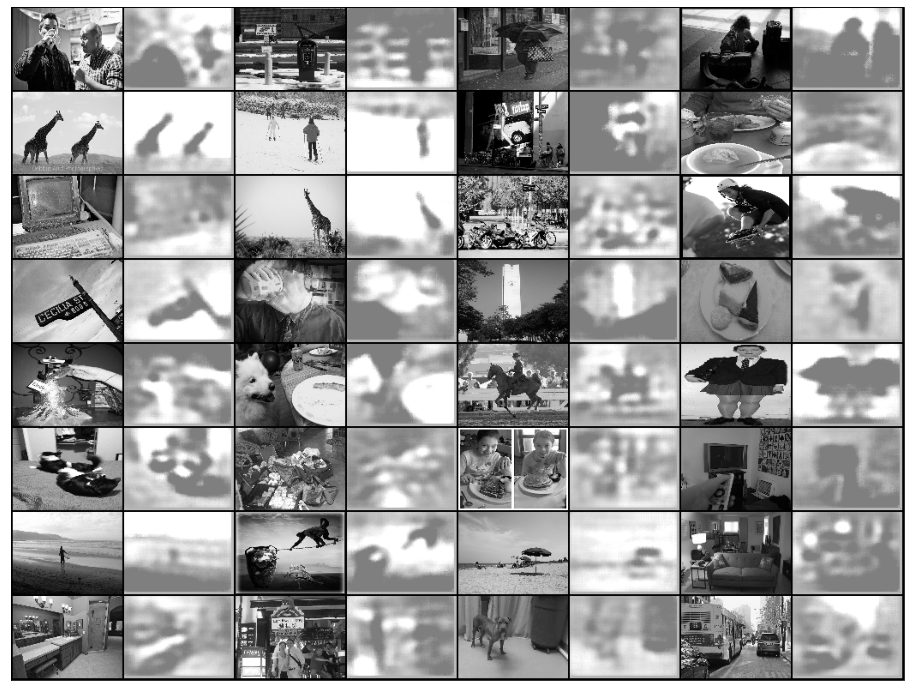

iter [210], loss:0.2147
iter [210], val loss:0.1950 


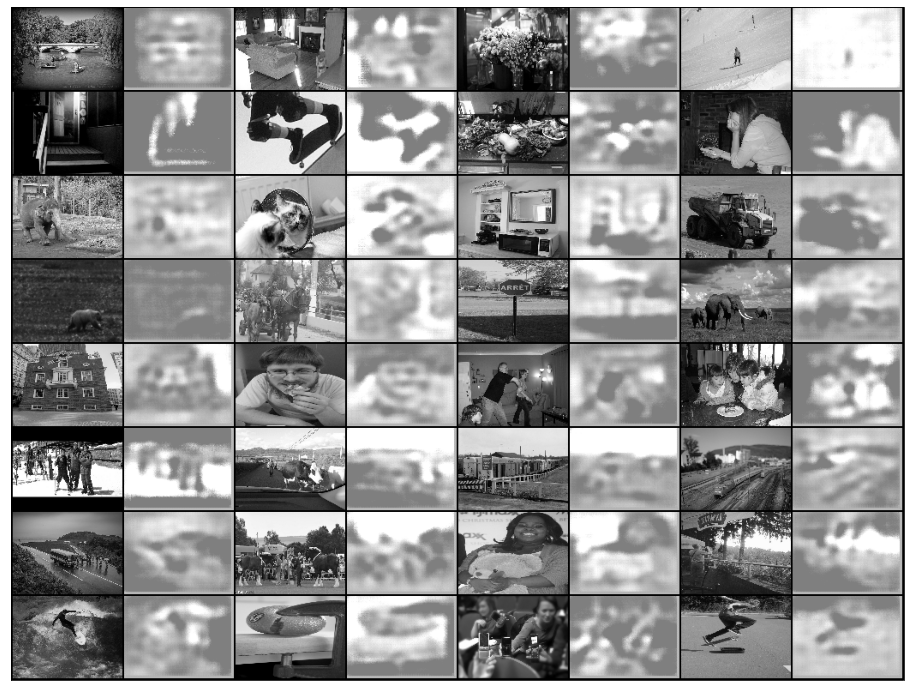

iter [220], loss:0.1873
iter [220], val loss:0.2023 


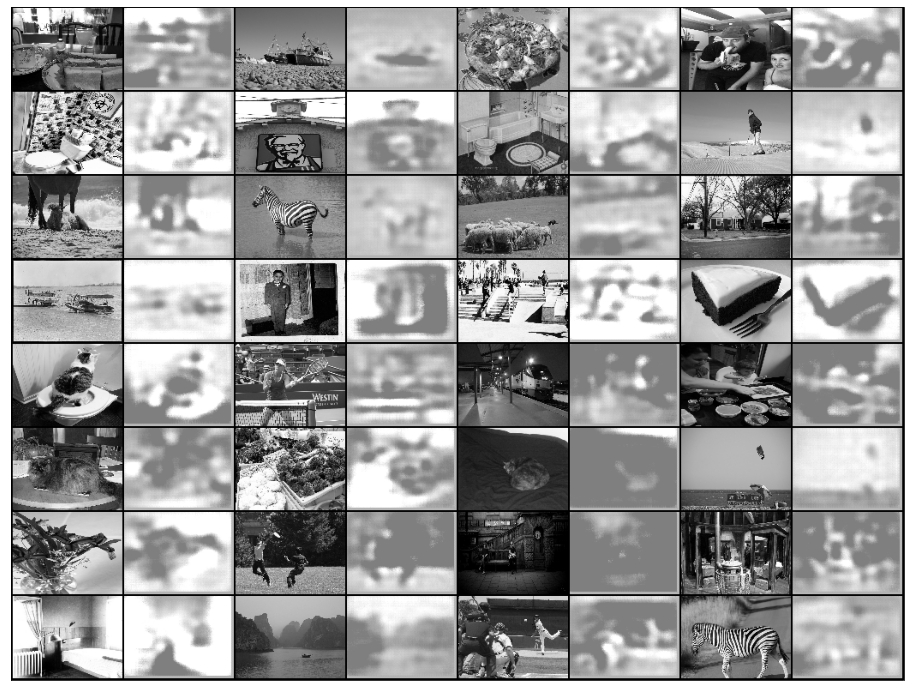

iter [230], loss:0.2043
iter [230], val loss:0.2022 


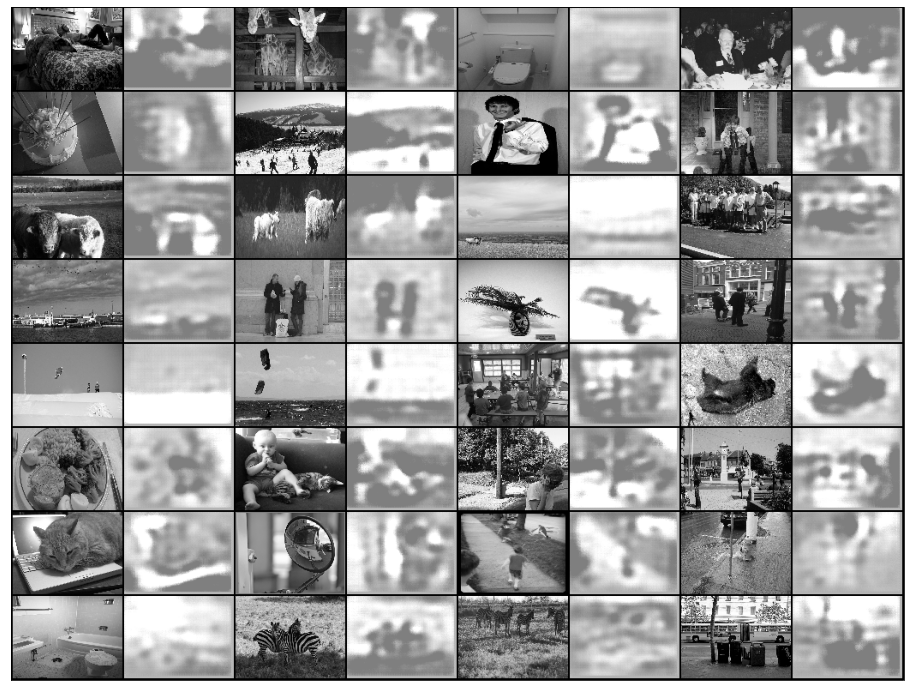

iter [240], loss:0.1927
iter [240], val loss:0.1814 


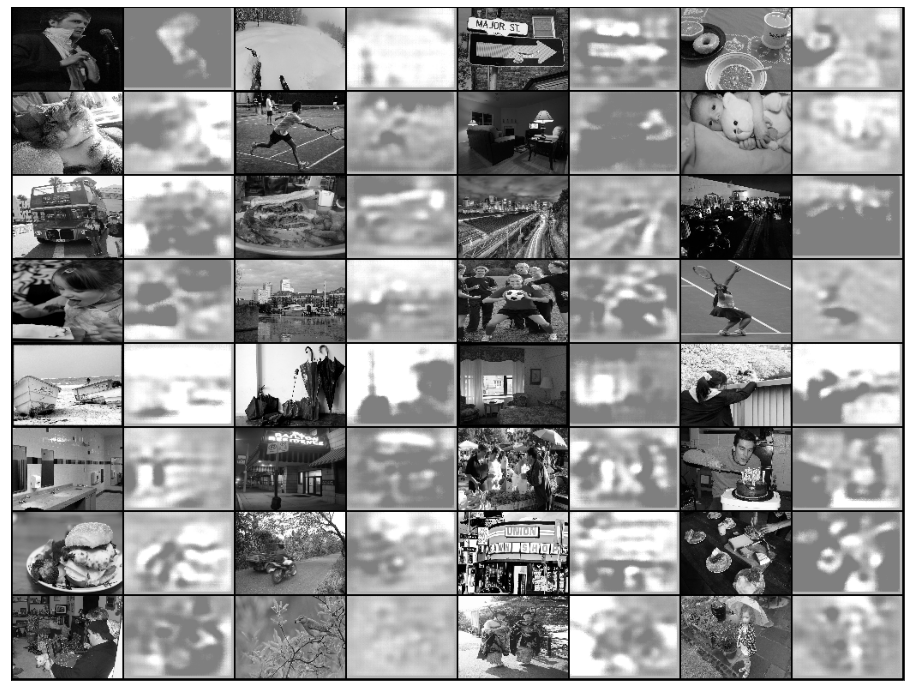

iter [250], loss:0.1933
iter [250], val loss:0.1791 


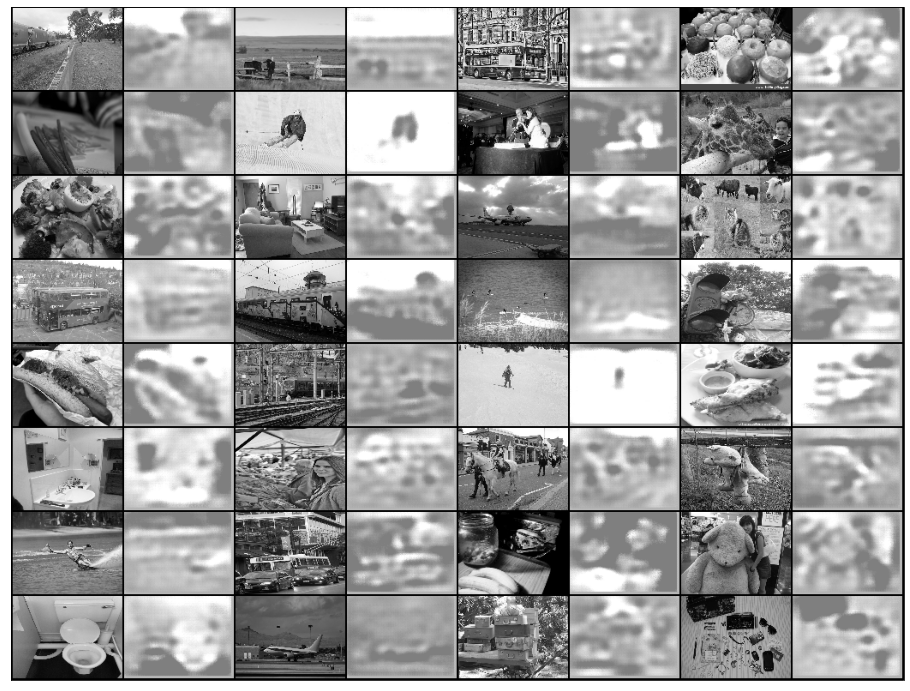

iter [260], loss:0.1804
iter [260], val loss:0.1678 


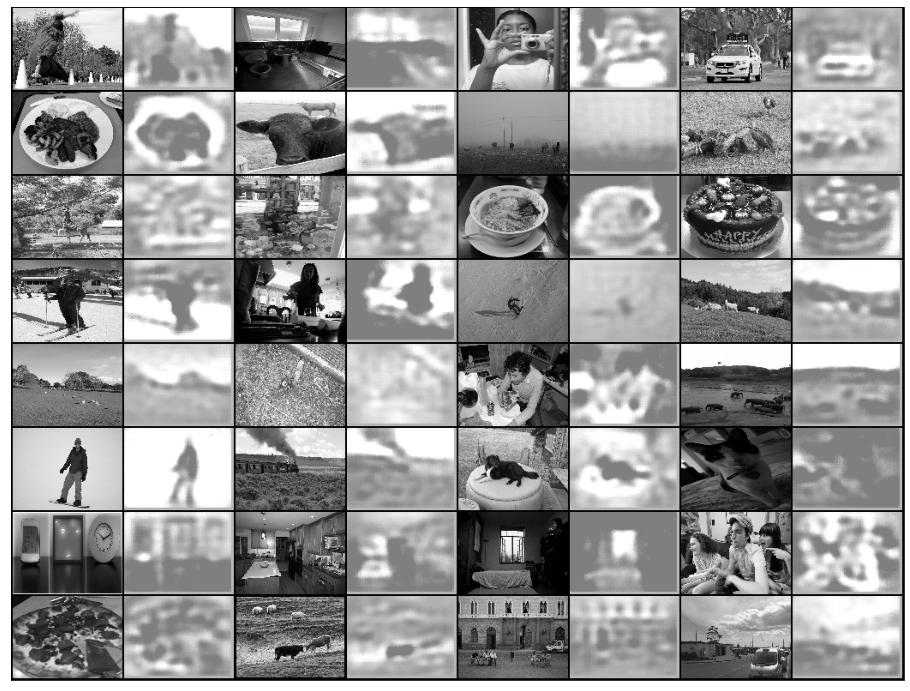

iter [270], loss:0.1773
iter [270], val loss:0.1492 


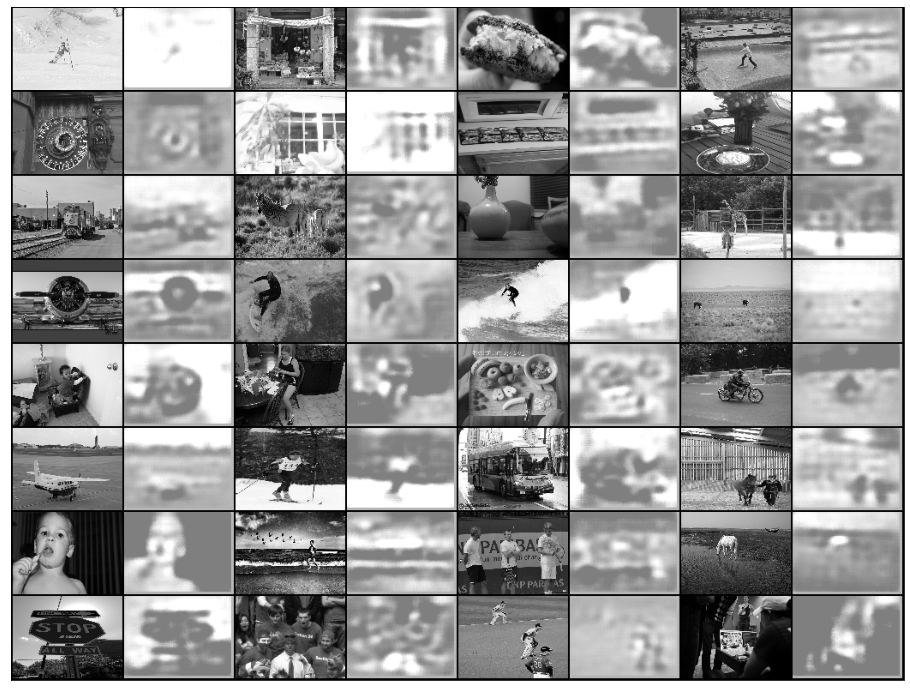

iter [280], loss:0.1540
iter [280], val loss:0.1690 


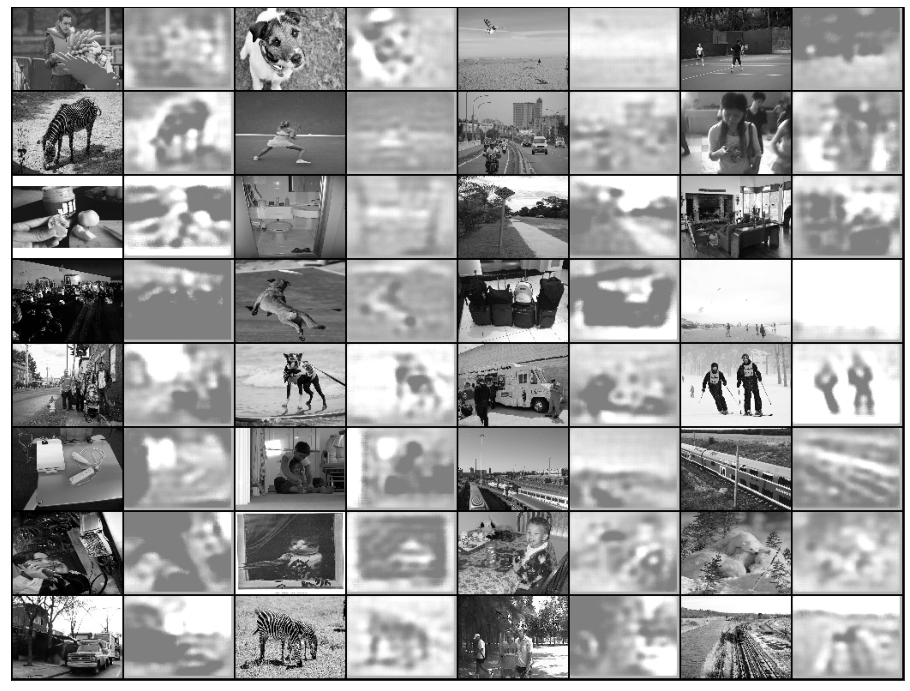

iter [290], loss:0.1819
iter [290], val loss:0.1673 


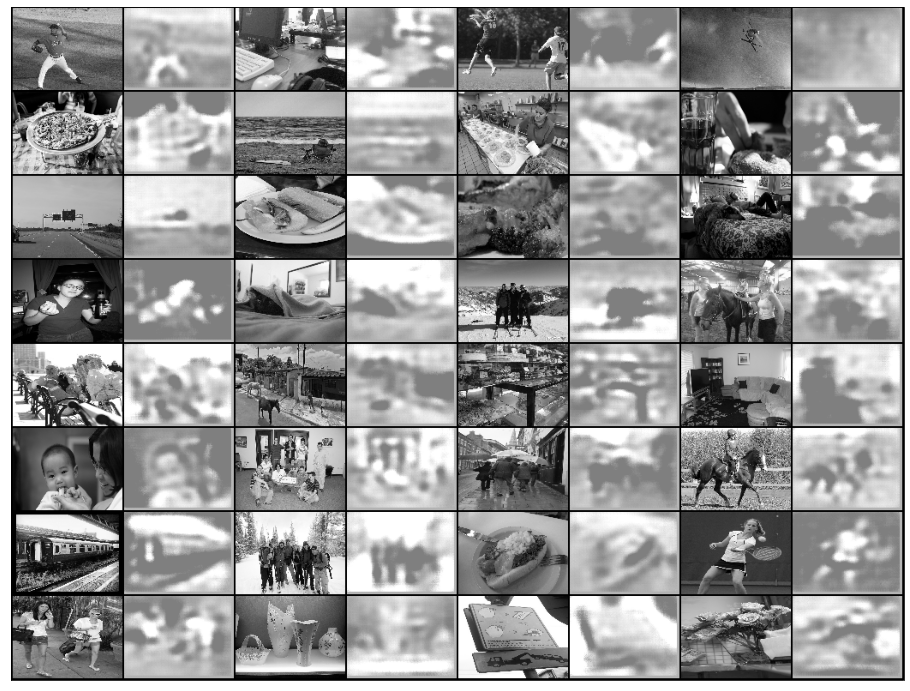

iter [300], loss:0.1558
iter [300], val loss:0.1609 


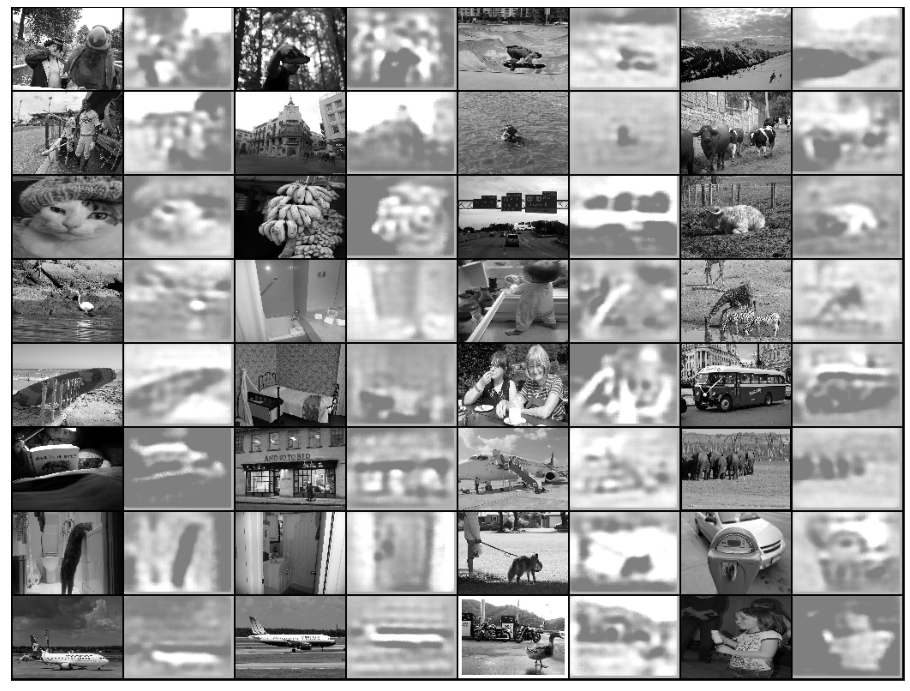

iter [310], loss:0.1439
iter [310], val loss:0.1520 


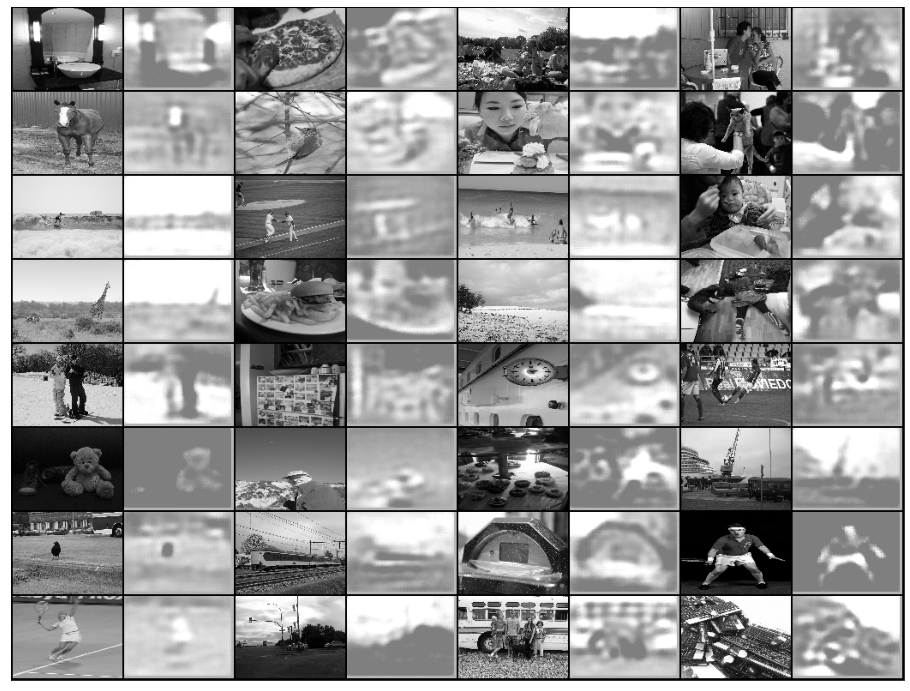

iter [320], loss:0.1339
iter [320], val loss:0.1509 


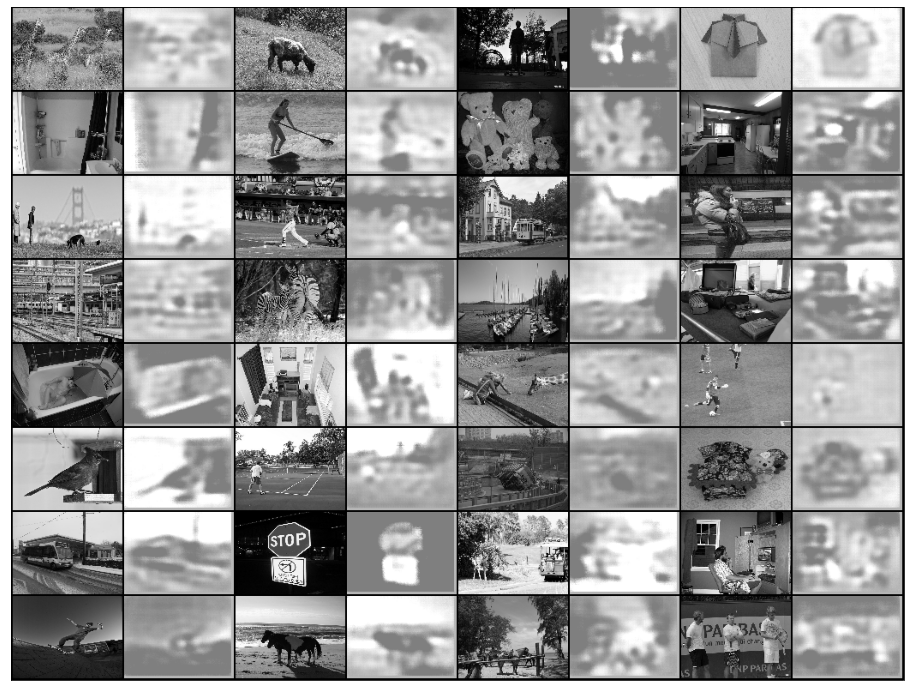

iter [330], loss:0.1410
iter [330], val loss:0.1361 


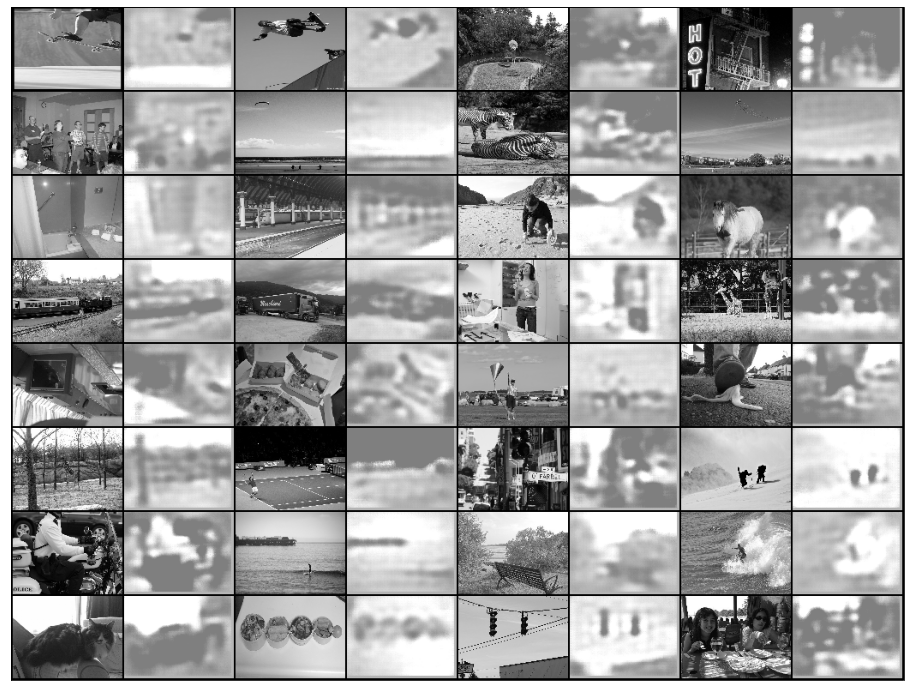

iter [340], loss:0.1522
iter [340], val loss:0.1411 


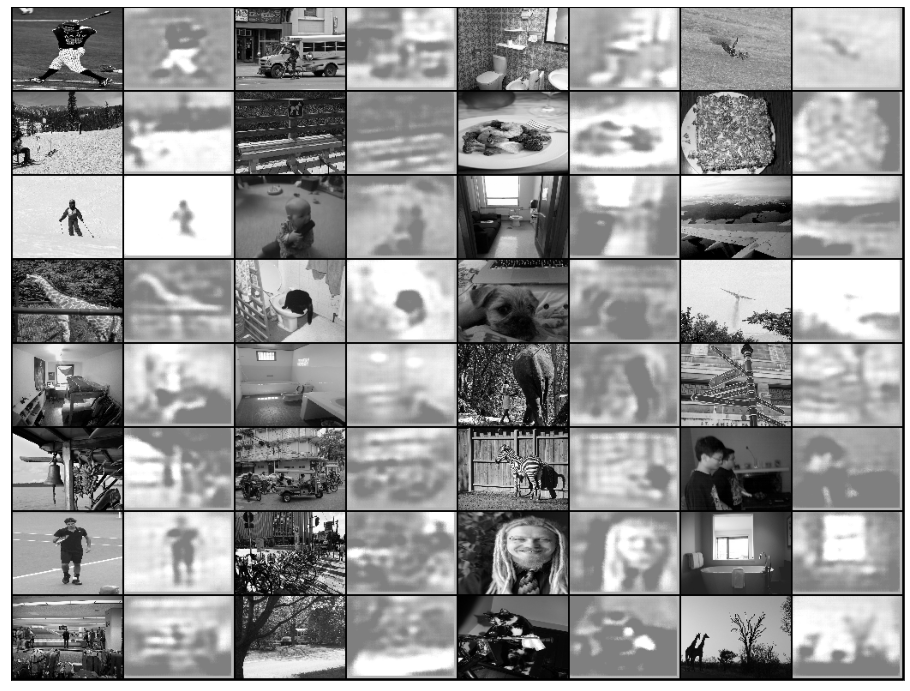

iter [350], loss:0.1346
iter [350], val loss:0.1440 


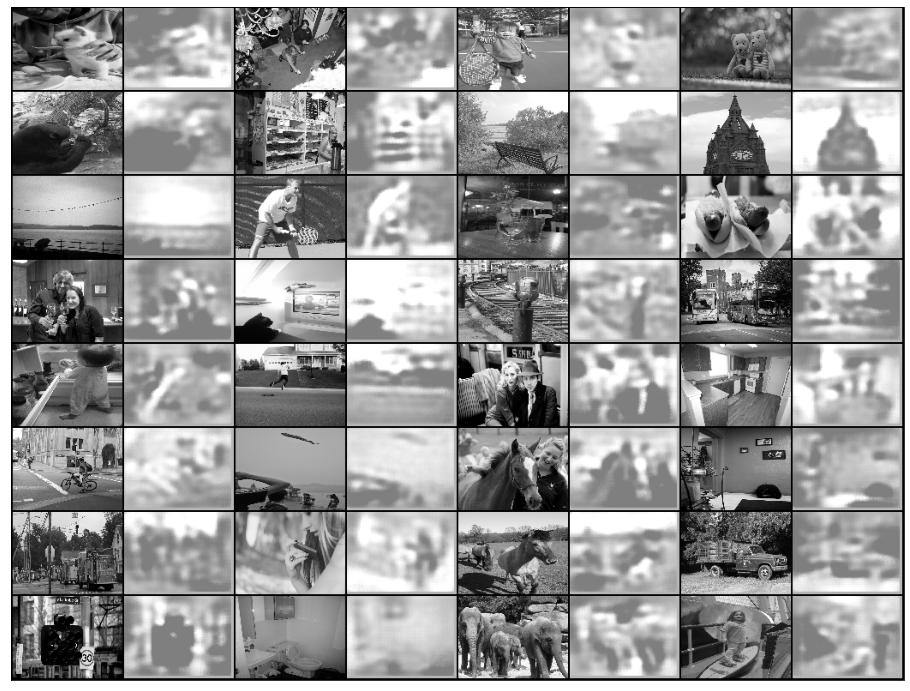

iter [360], loss:0.1277
iter [360], val loss:0.1332 


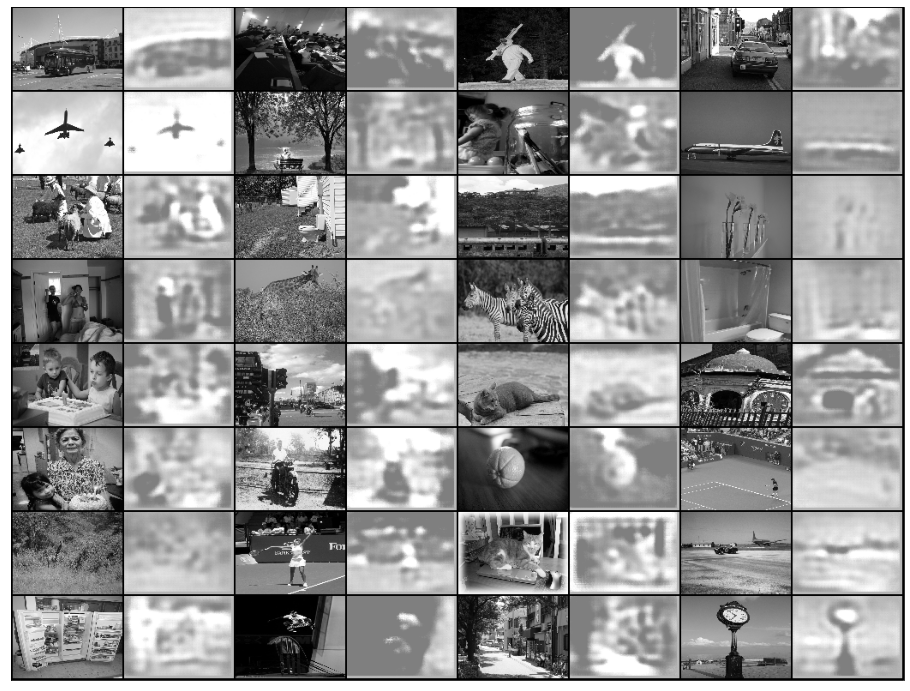

iter [370], loss:0.1340
iter [370], val loss:0.1389 


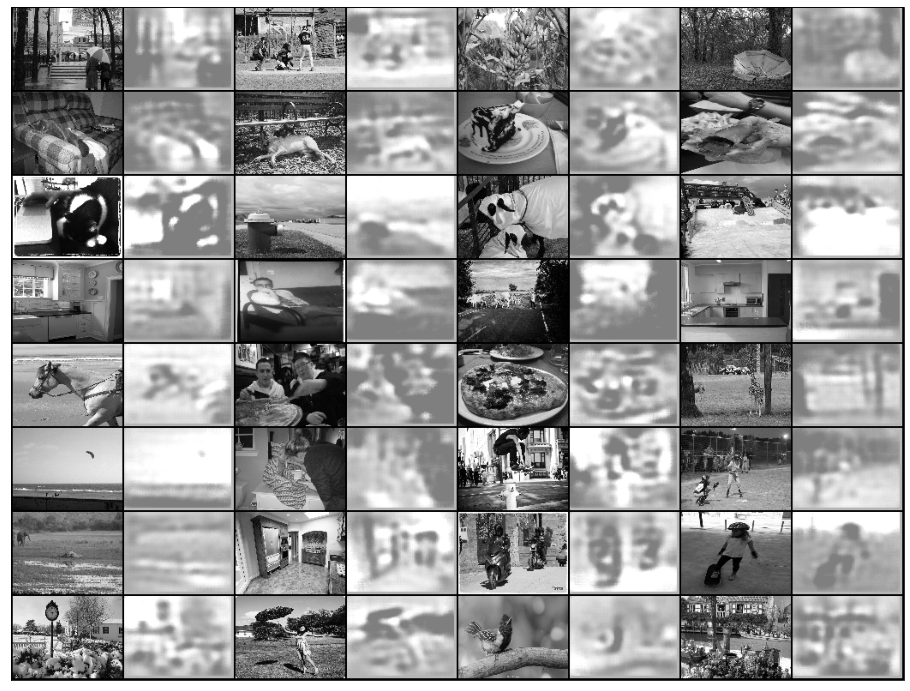

iter [380], loss:0.1349
iter [380], val loss:0.1445 


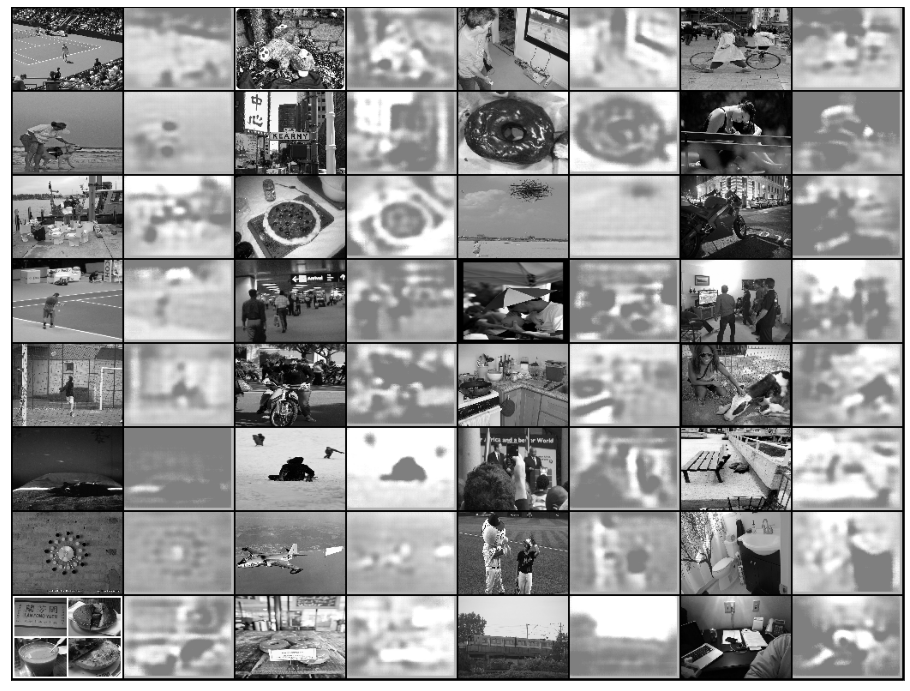

iter [390], loss:0.1280
iter [390], val loss:0.1283 


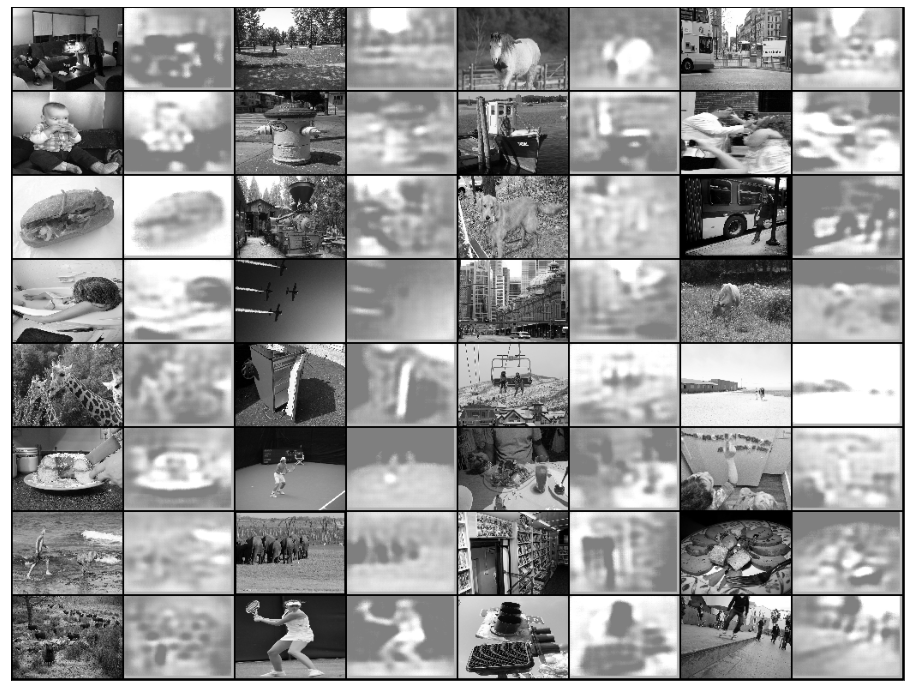

iter [400], loss:0.1142
iter [400], val loss:0.1282 


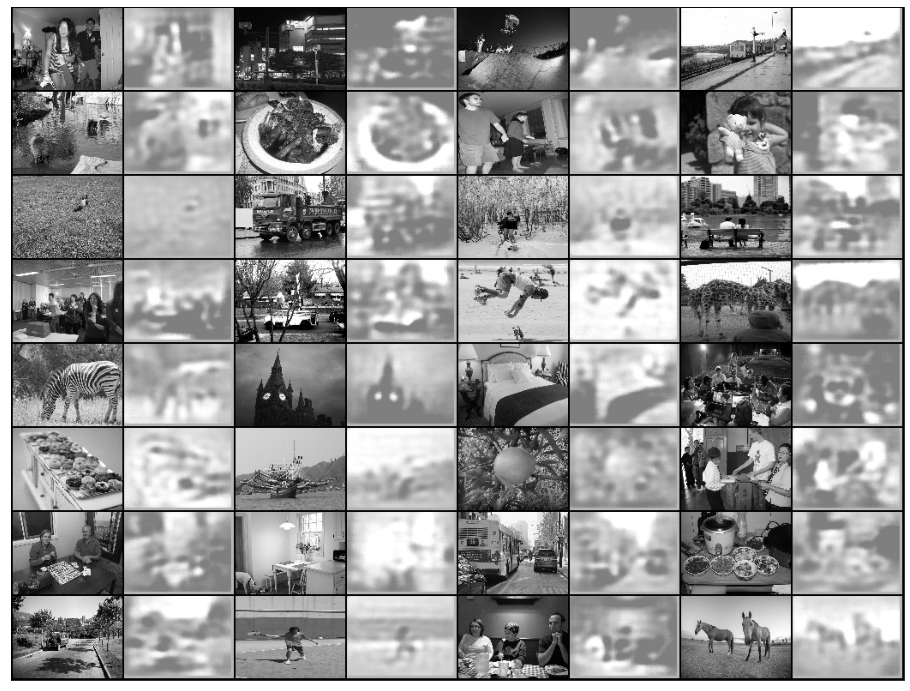

iter [410], loss:0.1213
iter [410], val loss:0.1300 


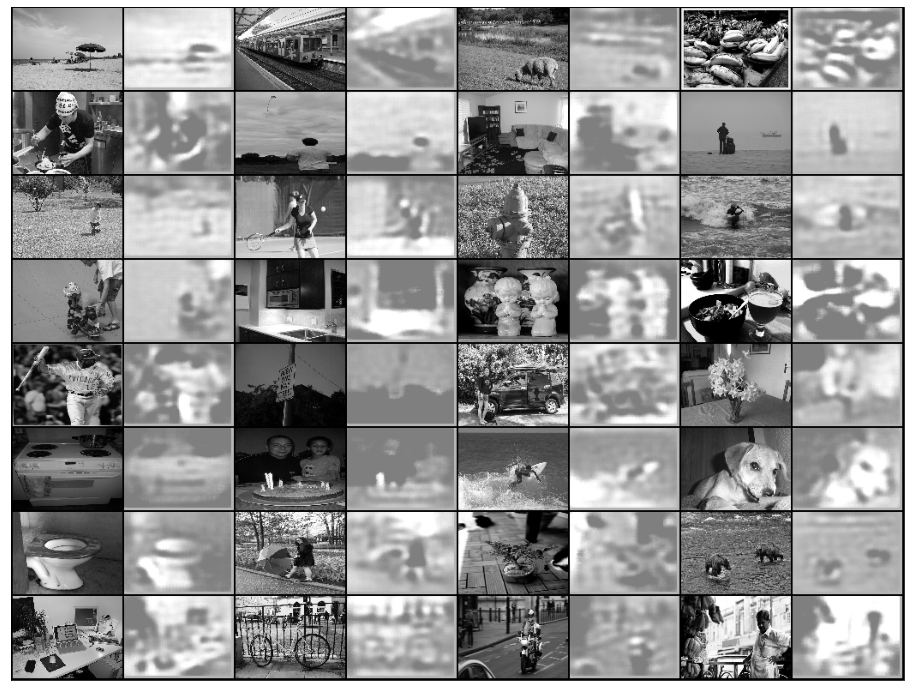

iter [420], loss:0.1232
iter [420], val loss:0.1358 


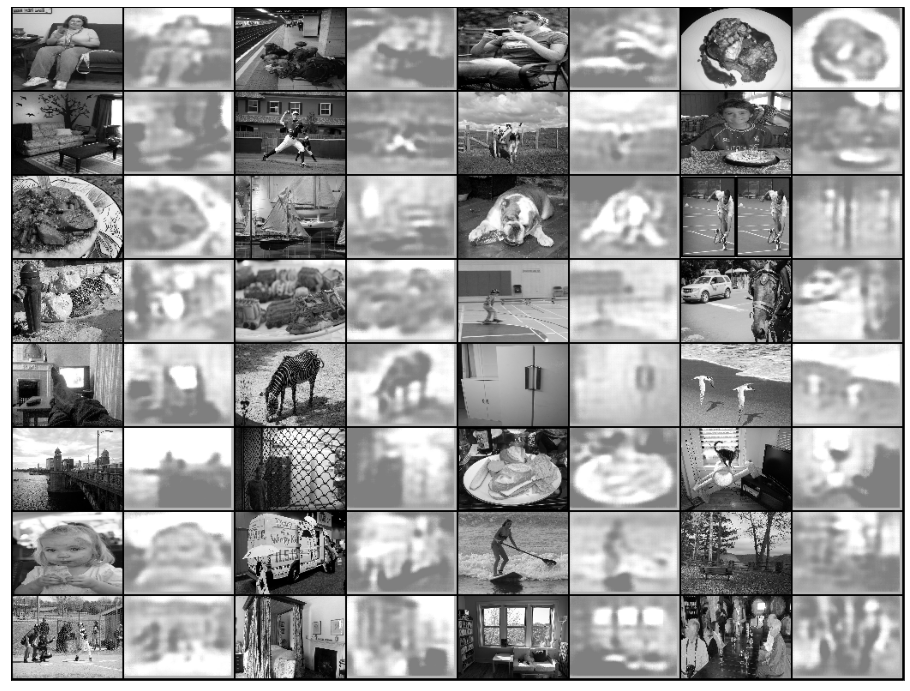

iter [430], loss:0.1134
iter [430], val loss:0.1143 


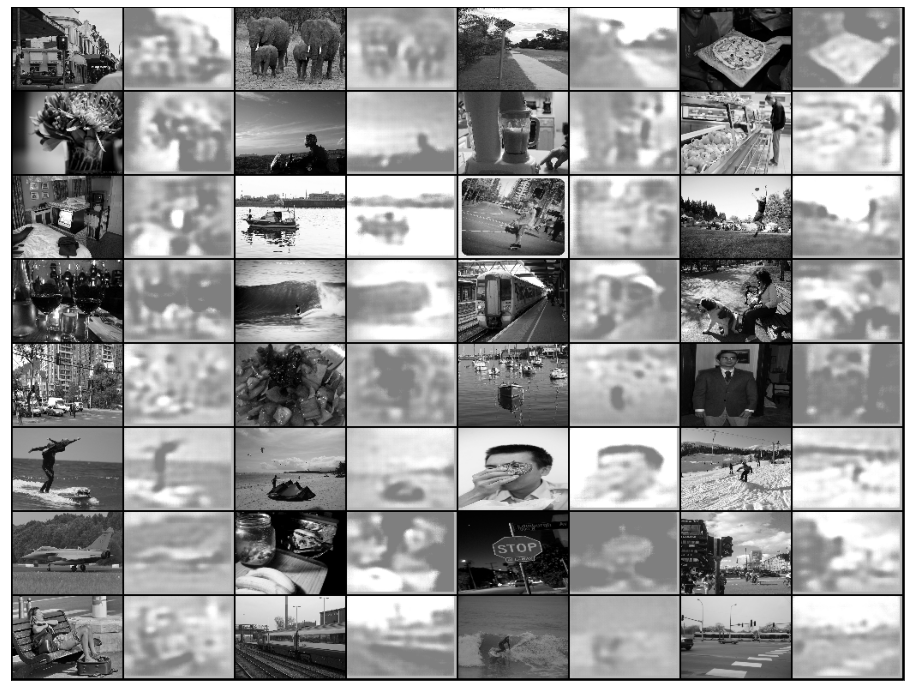

iter [440], loss:0.1059
iter [440], val loss:0.1205 


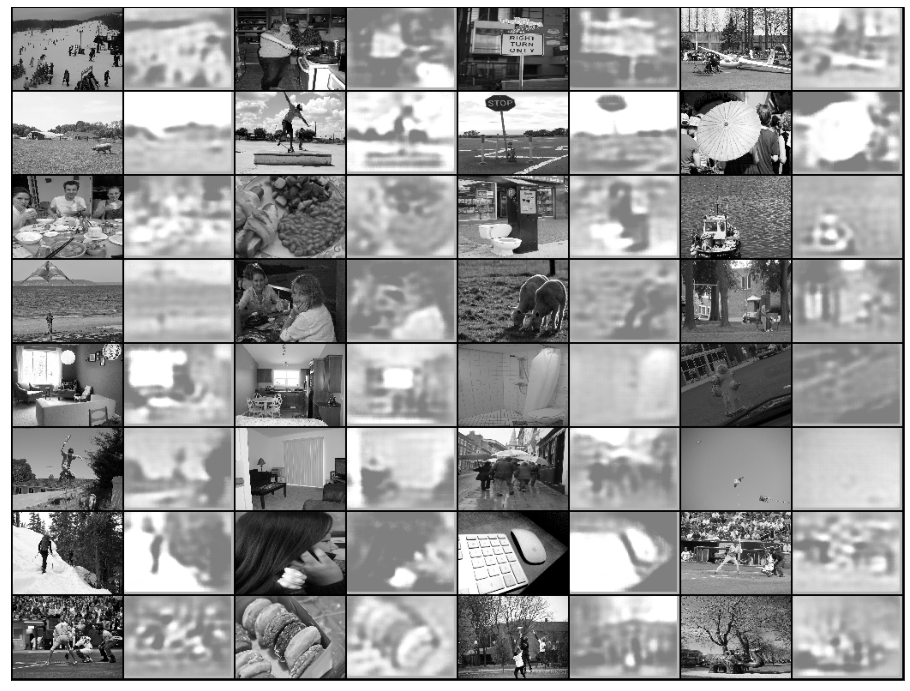

iter [450], loss:0.1160
iter [450], val loss:0.1089 


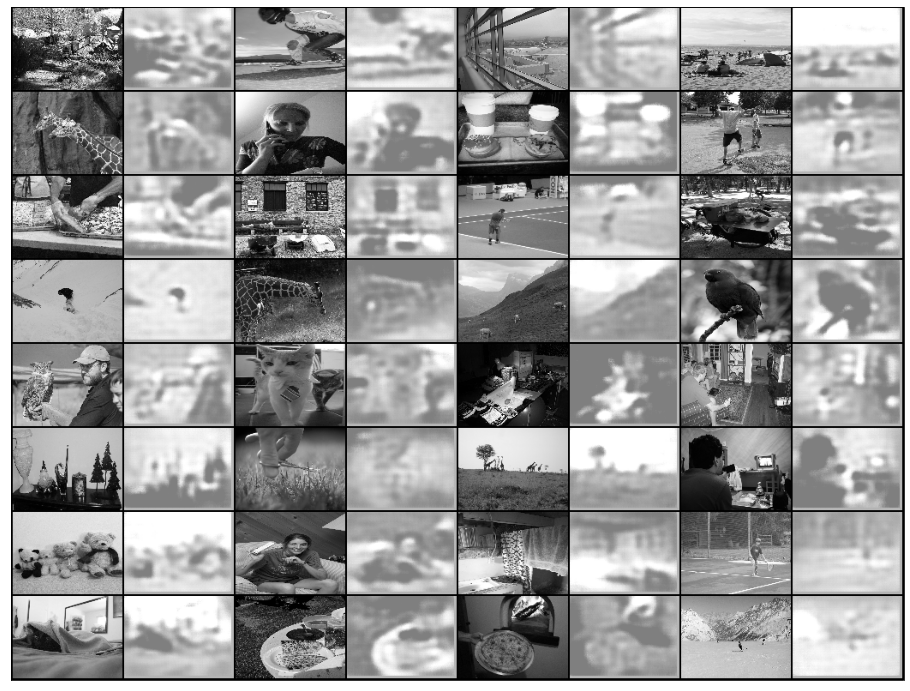

iter [460], loss:0.1168
iter [460], val loss:0.1205 


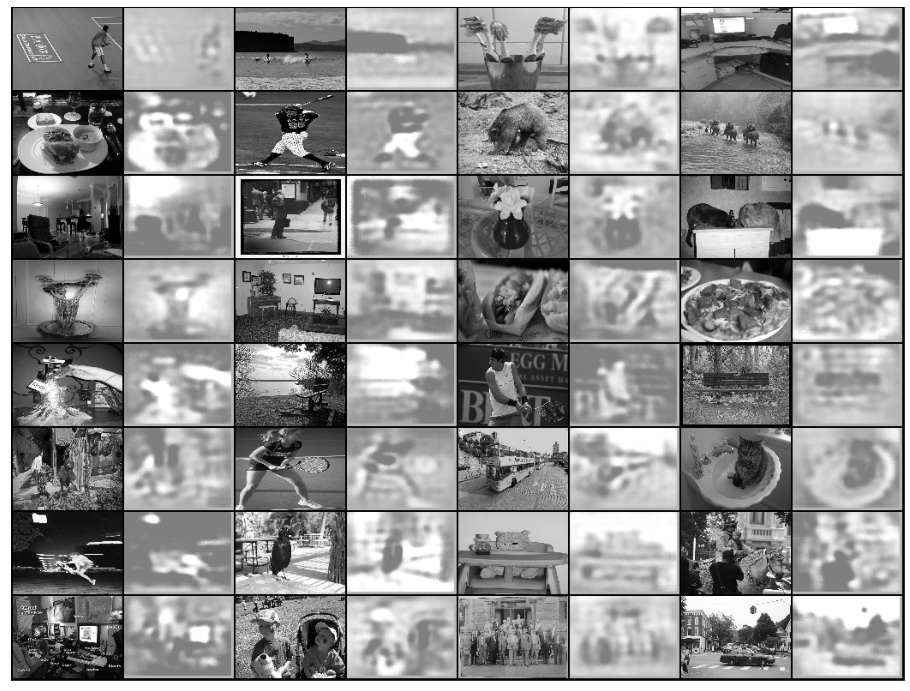

iter [470], loss:0.1074
iter [470], val loss:0.0976 


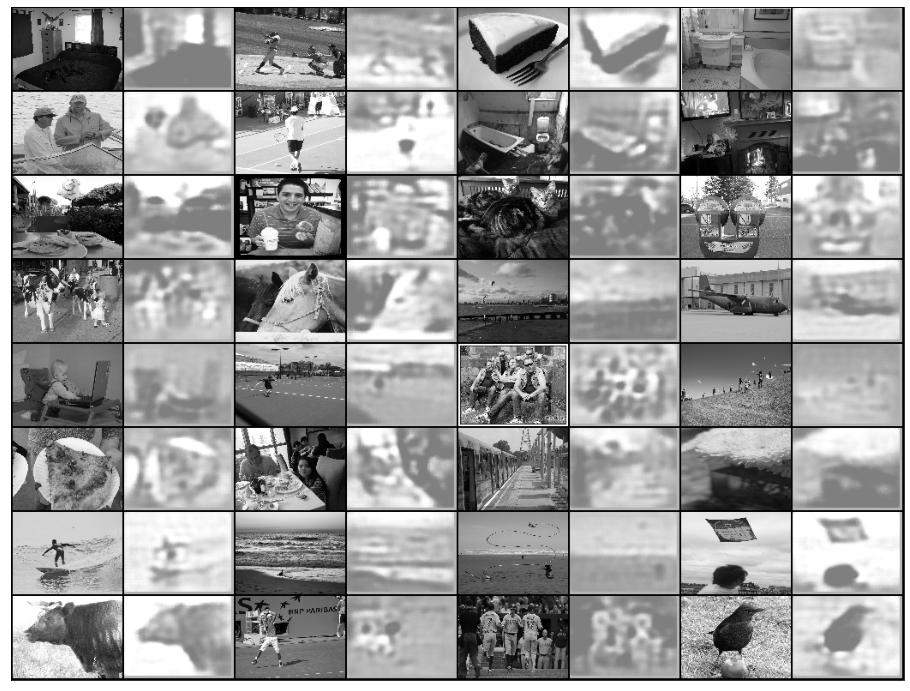

iter [480], loss:0.0929
iter [480], val loss:0.1205 


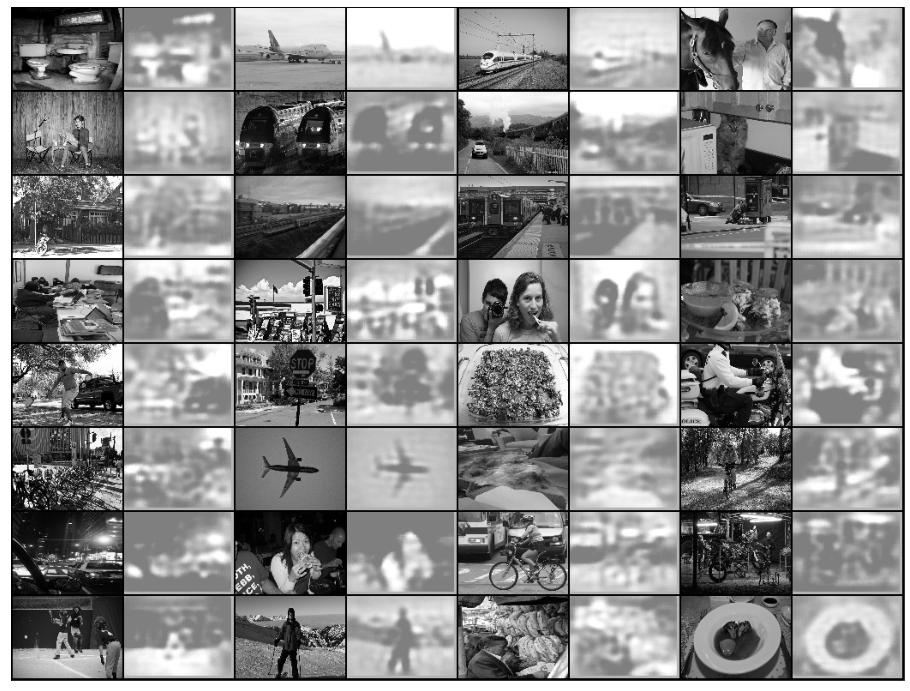

iter [490], loss:0.1043
iter [490], val loss:0.1051 


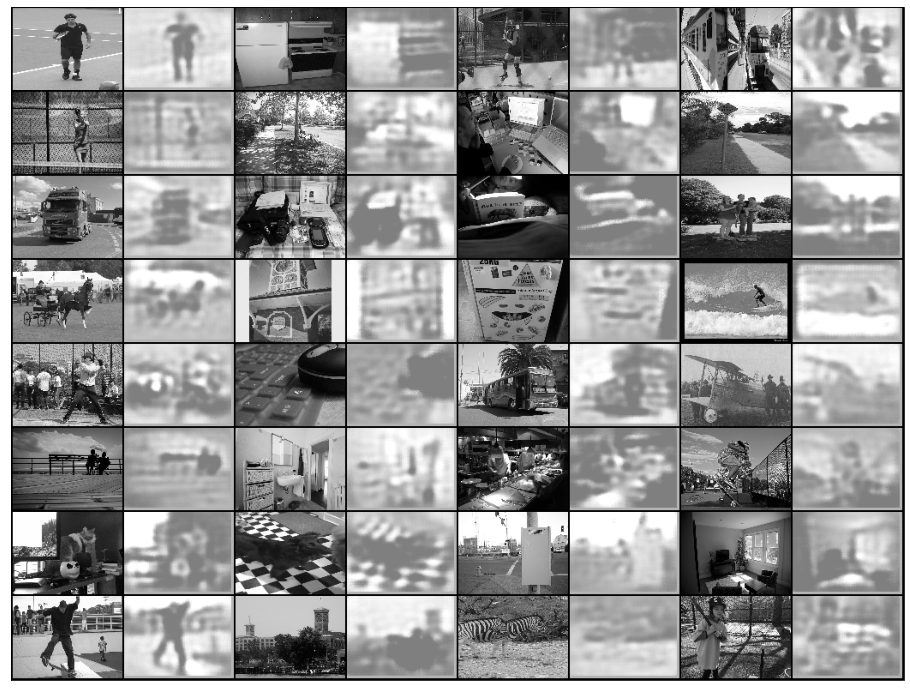

iter [500], loss:0.0986
iter [500], val loss:0.0912 


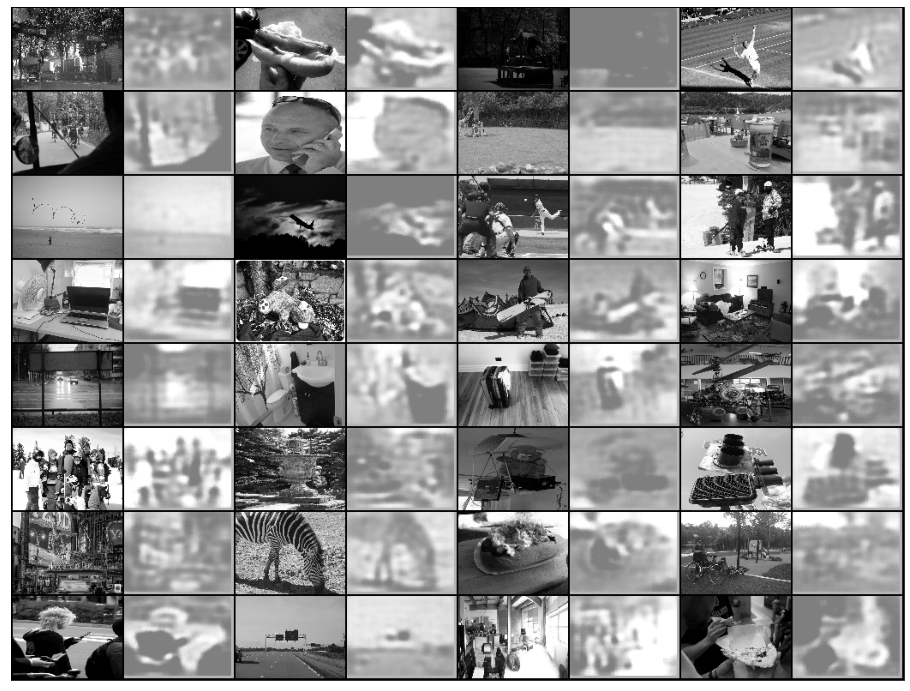

iter [510], loss:0.0924
iter [510], val loss:0.0951 


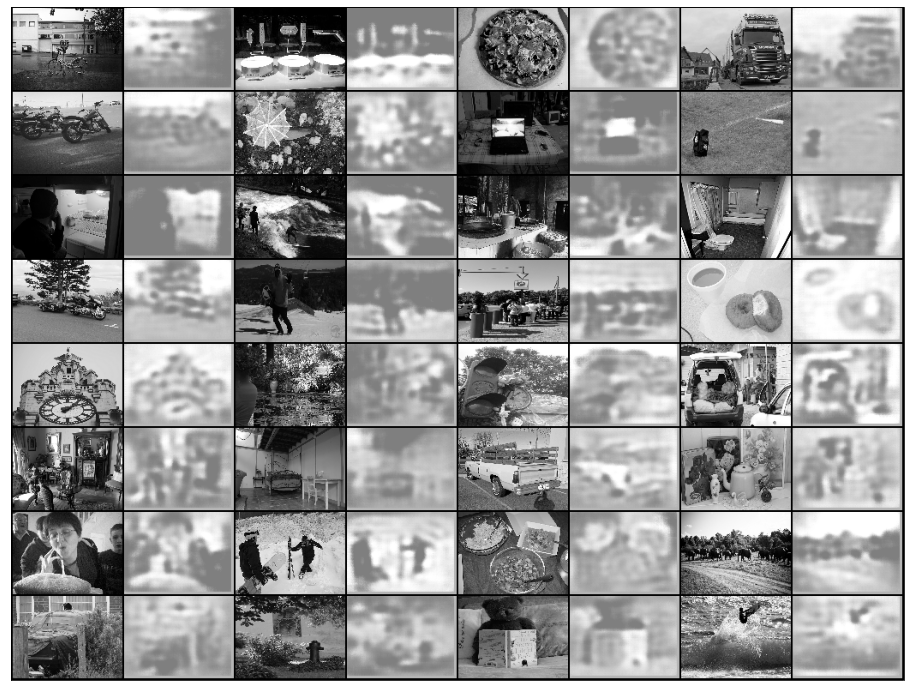

iter [520], loss:0.0963
iter [520], val loss:0.0966 


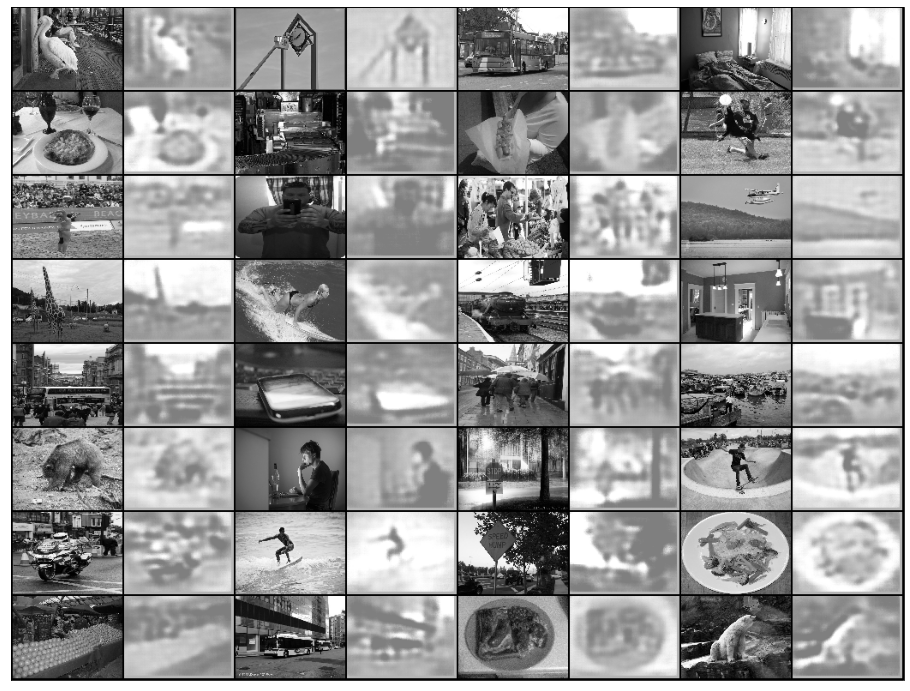

iter [530], loss:0.0911
iter [530], val loss:0.0886 


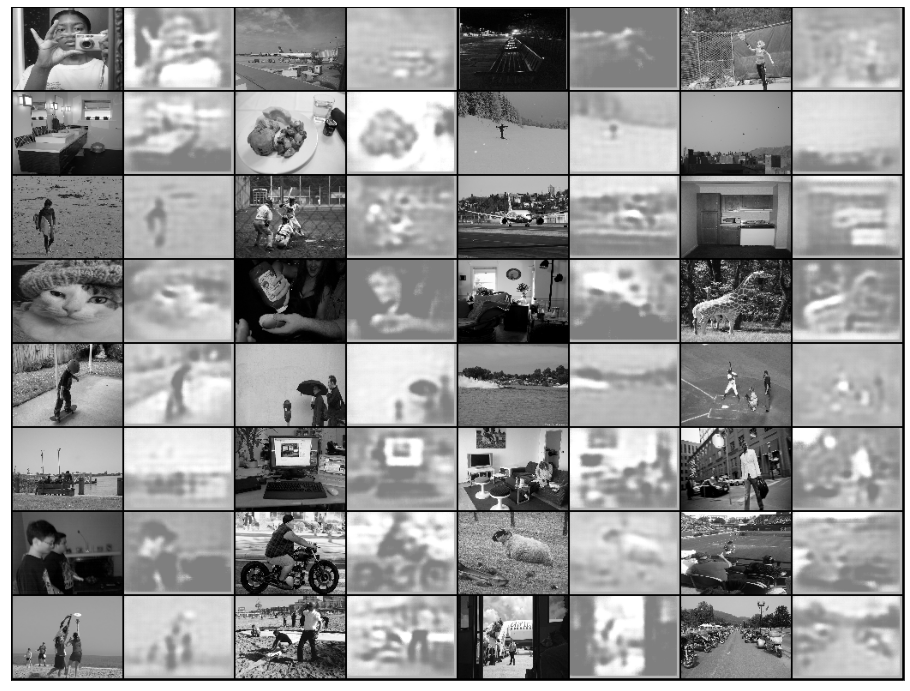

iter [540], loss:0.0982
iter [540], val loss:0.0941 


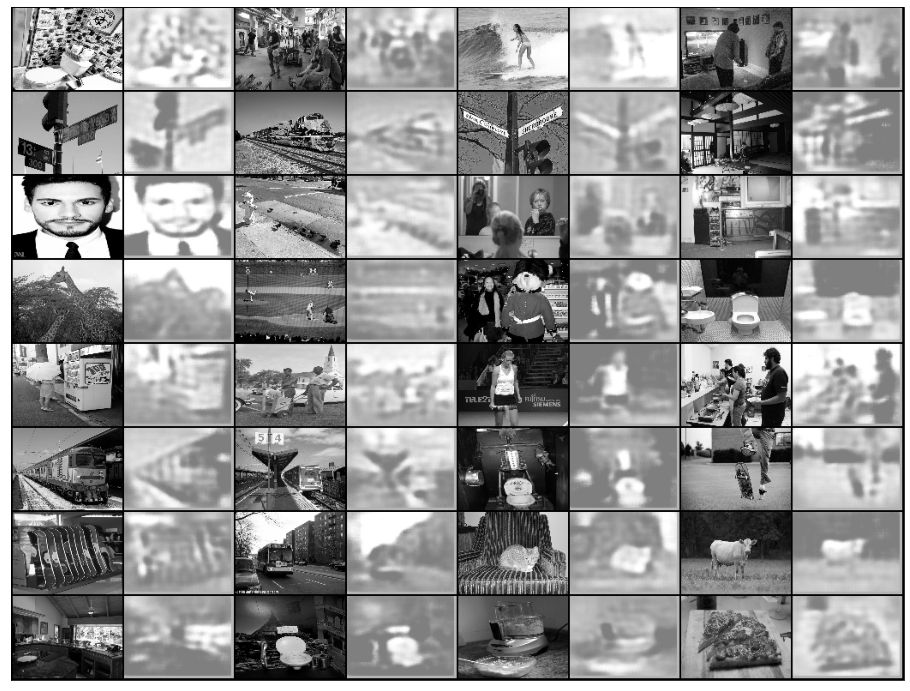

iter [550], loss:0.0817
iter [550], val loss:0.0999 


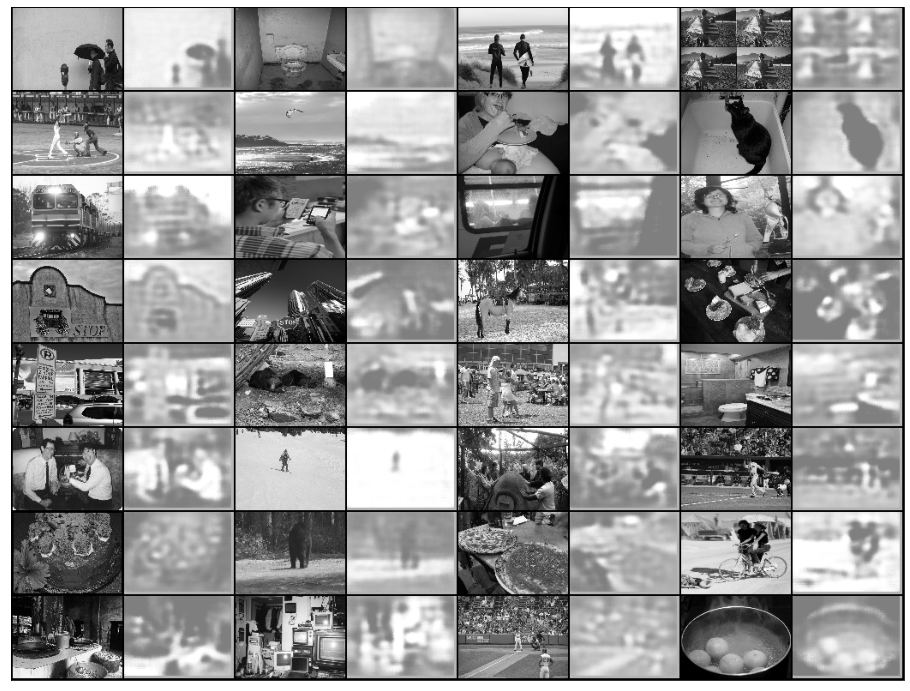

iter [560], loss:0.0912
iter [560], val loss:0.1023 
Buffered data was truncated after reaching the output size limit.

In [ ]:
# Define Loss function
def mse_loss(input, target):
    e = input[:,:,:] - target[:,:,:]
    mse = torch.mean(e**2)
    return mse

# Training Loop. Results will appear every 50th iteration.
itr = 0
for epoch in range(num_epochs):
    for data in train_dataloader:
        img, _ = data        
        img = Variable(img).to(device)

        # Forward
        output = model(img)
        loss = mse_loss(output, img)
        
        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
       
        if itr % 10 == 0:
            # Log
            torch.save(model.state_dict(), './autoencoder_model_black.pth')
            print('iter [{}], loss:{:.4f}'
               .format(itr, loss.data.item()))
            pic = to_img(output.to("cpu").data)
            
            with torch.no_grad():
              val_data = next(iter(val_dataloader))
              val_img, _ = val_data
              val_img = Variable(val_img).to(device)
              val_output = model(val_img)
              val_r_loss = mse_loss(val_output, val_img)
              
              print('iter [{}], val loss:{:.4f} '
                .format(itr, val_r_loss.data.item(),))
              
              val_pic = to_img(val_output.to("cpu").data)
              val_pic_orig = val_data[0]
              btch_list = []
              for i in range(val_pic.shape[0]):
                btch_list.append(val_pic_orig[i:i+1,:,:,:])
                btch_list.append((val_pic[i,:,:]).unsqueeze(0))
              btch = torch.cat(btch_list)
              fig = plt.figure(  figsize=(16, 16))
              btch = btch.to(device)[:64]
              ax = plt.imshow(np.transpose(vutils.make_grid(btch, padding=2, normalize=True).cpu(),(1,2,0)))
              ax.axes.get_xaxis().set_visible(False)
              ax.axes.get_yaxis().set_visible(False)
              plt.show(fig)
        
            
        itr += 1

    print('epoch [{}/{}], loss:{:.4f}'
          .format(epoch + 1, num_epochs, loss.data.item()))

# Save Weights
torch.save(model.state_dict(), './coco_color_3-128-128_128_autoencoder_statedictRGB.pth')

